1. 데이터 수집 및 로딩
parse_raw_annotations() 함수 구현 및 실행

잘못된 바운딩 박스 제거 (xmax > width, ymax > height)

label_idx 생성 및 클래스 매핑 저장 (label_map.json)

최종 train_df.csv 저장

2. 데이터 분포 확인 및 EDA
value_counts(), plot(kind="bar")로 클래스 분포 확인

소수 클래스 확인 및 불균형 탐색

데이터 누락, 이상치 등 탐색

3. 데이터 증강 설계 및 적용
train_transforms, val_transforms, test_transforms 정의

ex. Resize, Flip, Brightness, Normalize 등 구성

소수 클래스 대상으로 targeted augmentation 기획 및 반영 가능 (아래 참고)

4. Custom Dataset 클래스 작성 및 테스트
PillDataset 정의 및 bbox 좌표 변환/정규화 등 구현

bbox 정규화 후 Albumentations 적용

image-to-target 매핑 오류 방지 처리

5. StratifiedGroupKFold를 통한 split
StratifiedGroupKFold 사용해 train_df, val_df 분할

그룹 단위 분할 및 불균형 방지

6. DataLoader 구축
train_loader, val_loader, test_loader 구성 및 collate_fn 정의

7. 기타 (선택적 / 협업 영역 중 일부)
메모리 캐시 비우기 (gc.collect(), torch.cuda.empty_cache())

클래스 리스트 classes 생성

로그를 위한 클래스 매핑 정리 등



In [4]:
from google.colab import drive
drive.mount('/content/drive')

import os

project_path = '/content/drive/MyDrive/초급 프로젝트 데이터 모음'

os.chdir(project_path)

print("현재 디렉토리:", os.getcwd())

Mounted at /content/drive
현재 디렉토리: /content/drive/MyDrive/초급 프로젝트 데이터 모음


In [ ]:
!pip install torchmetrics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 981.9/981.9 kB 27.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 62.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 33.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 36.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 69.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

# 1. 데이터 초기 설정

1. 라이브러리 임포트, 초기 설정

In [ ]:
import os  # 디렉토리, 파일 경로 조작 등

import torch
import os
import numpy as np

from pathlib import Path  # payhon path

import albumentations as A
import cv2  # OpenCV - 고급 이미지/비디오 처리
import torch
from torch.utils.data import Dataset  # 커스텀 데이터셋, 배치 로딩
import pandas as pd
import os
import json
from tqdm import tqdm
from pathlib import Path

# Garbage Collector 모듈
import gc

from torchmetrics.detection.mean_ap import MeanAveragePrecision


# 메모리 정리 루틴
gc.collect()
torch.cuda.empty_cache()


# --- 디바이스 설정 ---
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
SEED = 42

# --- 학습 하이퍼파라미터 ---
BATCH_SIZE = 16
NUM_EPOCHS = 300
LEARNING_RATE = 1e-4
MOMENTUM = 0.9
WEIGHT_DECAY = 0.0005

2. 경로 설정

In [ ]:
# --- 데이터 경로 설정 ---
DATA_ROOT = project_path = '/content/drive/MyDrive/초급 프로젝트 데이터 모음'

  # 최상위 폴더

# 하위 디렉토리들
TRAIN_IMAGE_DIR = os.path.join(DATA_ROOT, "train_images")
TRAIN_ANNO_DIR = os.path.join(DATA_ROOT, "train_annotations")
TEST_IMAGE_DIR = os.path.join(DATA_ROOT, "test_images")

# 전처리된 CSV 저장 경로
PROCESSED_TRAIN_CSV = os.path.join(DATA_ROOT, "train_df.csv")

# --- 모델 설정 ---
NUM_CLASSES = 73
MODEL_NAME = "fasterrcnn_resnet50_fpn"
USE_PRETRAINED = True

# --- 학습 고도화 설정 ---
USE_SCHEDULER = True  # Learning rate scheduler 사용 여부
EARLY_STOPPING = True  # Early stopping 적용 여부
AUGMENTATION = True  # 데이터 증강 사용 여부

# --- 실험 로깅용 설정 ---
USE_WANDB = True
WANDB_PROJECT = "AI03-Project-1"
RUN_NAME = f"{MODEL_NAME}_bs{BATCH_SIZE}_lr{LEARNING_RATE}"


# --- 실험 결과 저장 경로 ---
EXPERIMENT_DIR = "../experiments"

3.annotations 파싱 함수 설정(하나의 dataframe으로 정리)

In [ ]:
def parse_raw_annotations(ann_dir: Path) -> pd.DataFrame:
    """
    3단계 폴더 구조의 어노테이션을 모두 읽어와서 DataFrame으로 파싱
    """
    all_annotations = []

    # Level 1: 이미지별 폴더
    image_level_dirs = os.listdir(ann_dir)
    for image_dir_name in tqdm(image_level_dirs, desc="[L1] Images"):
        image_dir_path = ann_dir / image_dir_name
        if not image_dir_path.is_dir():
            continue

        # Level 2: 알약 종류 폴더
        pill_level_dirs = os.listdir(image_dir_path)
        for pill_dir_name in pill_level_dirs:
            pill_dir_path = image_dir_path / pill_dir_name
            if not pill_dir_path.is_dir():
                continue

            # Level 3: 실제 JSON 파일 파싱
            json_files = [f for f in os.listdir(pill_dir_path) if f.endswith(".json")]
            if not json_files:
                continue

            json_file_path = pill_dir_path / json_files[0]

            try:
                with open(json_file_path, "r", encoding="utf-8") as f:
                    ann_data = json.load(f)

                    image_info = ann_data.get("images", [{}])[0]
                    categories = ann_data.get("categories", [])

                    # category_id → name 매핑
                    category_map = {cat["id"]: cat["name"] for cat in categories}

                    for ann in ann_data.get("annotations", []):
                        all_annotations.append(
                            {
                                "image_id": image_info.get("id"),
                                "file_name": image_info.get("file_name"),
                                "width": image_info.get("width"),
                                "height": image_info.get("height"),
                                "category_id": ann.get("category_id"),
                                "class_name": category_map.get(ann.get("category_id"), "UNKNOWN"),
                                "bbox": ann.get("bbox"),
                            }
                        )
            except Exception as e:
                print(f"\n❌ 파일 처리 에러: {json_file_path}, 에러: {e}")

    return pd.DataFrame(all_annotations)


4. train/annotations/test 경로 설정

In [ ]:
# 1. 핵심 함수를 호출해서 DataFrame 생성
from pathlib import Path

# Google Drive 기준 절대 경로 지정

BASE_DIR = Path('/content/drive/MyDrive/초급 프로젝트 데이터 모음')

RAW_DATA_DIR = BASE_DIR
PROCESSED_DATA_DIR = BASE_DIR  # 저장도 동일한 곳에 할 경우

TRAIN_IMAGE_DIR = RAW_DATA_DIR / "train_images"
TRAIN_ANNO_DIR = RAW_DATA_DIR / "train_annotations"
TEST_IMAGE_DIR = RAW_DATA_DIR / "test_images"
SAVE_PATH = PROCESSED_DATA_DIR / "train_df.csv"

5. annotations 파싱 -> dataframe 생성, bbox 컬럼 분리 -> 학습 가능한 형태로 전처리

In [ ]:
from tqdm.notebook import tqdm


In [ ]:
# 어노테이션 파싱함수 -> train_annotations_df라는 dataframe생성
train_annotations_df = parse_raw_annotations(TRAIN_ANNO_DIR)

[L1] Images:   0%|          | 0/498 [00:00<?, ?it/s]

In [ ]:
# DataLoader에서 이미지와 타겟을 리스트로 묶어주는 함수
def collate_fn(batch):
    return tuple(zip(*batch))


In [ ]:
train_annotations_df.head()

,image_id,file_name,width,height,category_id,class_name,bbox
0,1417,K-001900-010224-016551-031705_0_2_0_2_70_000_2...,976,1280,1899,보령부스파정 5mg,"[645, 859, 210, 158]"
1,1418,K-001900-010224-016551-031705_0_2_0_2_75_000_2...,976,1280,16550,동아가바펜틴정 800mg,"[109, 648, 288, 496]"
2,1419,K-001900-010224-016551-031705_0_2_0_2_90_000_2...,976,1280,31704,낙소졸정 500/20mg,"[617, 735, 254, 448]"
3,410,K-001900-010224-016551-033009_0_2_0_2_90_000_2...,976,1280,1899,보령부스파정 5mg,"[153, 253, 192, 168]"
4,409,K-001900-010224-016551-033009_0_2_0_2_75_000_2...,976,1280,16550,동아가바펜틴정 800mg,"[4, 730, 475, 316]"


In [ ]:
# --- (1). bbox 컬럼을 4개로 분리 ---
# bbox 컬럼 분리
bbox_df = pd.DataFrame(
    train_annotations_df["bbox"].tolist(), columns=["bbox_x", "bbox_y", "bbox_w", "bbox_h"]
)
train_annotations_df = pd.concat([train_annotations_df.drop("bbox", axis=1), bbox_df], axis=1)

In [ ]:
train_annotations_df.head()

,image_id,file_name,width,height,category_id,class_name,bbox_x,bbox_y,bbox_w,bbox_h
0,1417,K-001900-010224-016551-031705_0_2_0_2_70_000_2...,976,1280,1899,보령부스파정 5mg,645,859,210,158
1,1418,K-001900-010224-016551-031705_0_2_0_2_75_000_2...,976,1280,16550,동아가바펜틴정 800mg,109,648,288,496
2,1419,K-001900-010224-016551-031705_0_2_0_2_90_000_2...,976,1280,31704,낙소졸정 500/20mg,617,735,254,448
3,410,K-001900-010224-016551-033009_0_2_0_2_90_000_2...,976,1280,1899,보령부스파정 5mg,153,253,192,168
4,409,K-001900-010224-016551-033009_0_2_0_2_75_000_2...,976,1280,16550,동아가바펜틴정 800mg,4,730,475,316


bbox 컬럼 나눠서 생성 완료

#2. 데이터 전처리

5. 잘못된 바운딩 박스 데이터 제거

총 train_annotations_df 데이터 수 (전체 객체 수)

In [ ]:
# ✨ --- [핵심 수정] 잘못된 바운딩 박스 데이터 제거 ---
# xmax (bbox_x + bbox_w)가 이미지 너비(width)를 초과하는 경우
invalid_x = train_annotations_df["bbox_x"] + train_annotations_df["bbox_w"] > train_annotations_df["width"]
# ymax (bbox_y + bbox_h)가 이미지 높이(height)를 초과하는 경우
invalid_y = train_annotations_df["bbox_y"] + train_annotations_df["bbox_h"] > train_annotations_df["height"]

# 잘못된 데이터를 필터링
invalid_rows = train_annotations_df[invalid_x | invalid_y]
if not invalid_rows.empty:
    print(f"--- {len(invalid_rows)}개의 잘못된 바운딩 박스 데이터를 찾았습니다. ---")
    print(
        invalid_rows[
            ["file_name", "width", "height", "bbox_x", "bbox_y", "bbox_w", "bbox_h"]
        ]
    )

    # 유효한 데이터만 남김
    train_annotations_df = train_annotations_df[~(invalid_x | invalid_y)]
    print(f"\n잘못된 데이터를 제거하고, {len(train_annotations_df)}개의 데이터만 사용합니다.")

--- 2개의 잘못된 바운딩 박스 데이터를 찾았습니다. ---
                                              file_name  width  height  \
680       K-003351-016262-018357_0_2_0_2_75_000_200.png    976    1280   
1721  K-003544-004543-012247-016551_0_2_0_2_70_000_2...    976    1280   

      bbox_x  bbox_y  bbox_w  bbox_h  
680     6567     625     311     315  
1721     653    8889     217     217  

잘못된 데이터를 제거하고, 1874개의 데이터만 사용합니다.


이미지 벗어나는 bbox 제거

In [ ]:
# 가로(x축) 초과 바운딩 박스 확인
invalid_x = train_annotations_df["bbox_x"] + train_annotations_df["bbox_w"] > train_annotations_df["width"]

# 세로(y축) 초과 바운딩 박스 확인
invalid_y = train_annotations_df["bbox_y"] + train_annotations_df["bbox_h"] > train_annotations_df["height"]

# 이상치 개수 출력
print(f" x축 초과 바운딩 박스 개수: {invalid_x.sum()}")
print(f" y축 초과 바운딩 박스 개수: {invalid_y.sum()}")


 x축 초과 바운딩 박스 개수: 0
 y축 초과 바운딩 박스 개수: 0


bbox 이상치 제거 = 완료

6. category_id → label_idx 매핑

| category\_id | label\_idx |
| ------------ | ---------- |
| 1001         | 1          |
| 1024         | 2          |
| 32155        | 3          |
| ...          | ...        |


이미지 크기 20%보다 작은 / 80% 넘는 바운딩 박스 확인

In [ ]:
# 너무 작은 바운딩 박스 기준 설정 (예: 너비 또는 높이가 20px 이하)
small_bbox = (train_annotations_df["bbox_w"] < 20) | (train_annotations_df["bbox_h"] < 20)

# 개수 확인
print(f" 너무 작은 바운딩 박스 수: {small_bbox.sum()}")

# 확인해보기
print(train_annotations_df[small_bbox][["file_name", "bbox_x", "bbox_y", "bbox_w", "bbox_h"]].head())


 너무 작은 바운딩 박스 수: 0
Empty DataFrame
Columns: [file_name, bbox_x, bbox_y, bbox_w, bbox_h]
Index: []


In [ ]:
# 이미지 크기의 일정 비율(예: 80%)을 넘는 박스는 너무 큰 걸로 간주
too_large_bbox = (
    (train_annotations_df["bbox_w"] > train_annotations_df["width"] * 0.8) |
    (train_annotations_df["bbox_h"] > train_annotations_df["height"] * 0.8)
)

print(f"너무 큰 바운딩 박스 수: {too_large_bbox.sum()}")
print(train_annotations_df[too_large_bbox][["file_name", "bbox_x", "bbox_y", "bbox_w", "bbox_h"]].head())


너무 큰 바운딩 박스 수: 0
Empty DataFrame
Columns: [file_name, bbox_x, bbox_y, bbox_w, bbox_h]
Index: []


중복된 bbox 확인

In [ ]:
# 바운딩 박스 정보 기준으로 완전히 같은 row가 있는지 확인
duplicated_bbox = train_annotations_df.duplicated(subset=["file_name", "bbox_x", "bbox_y", "bbox_w", "bbox_h"], keep=False)

print(f"중복된 바운딩 박스 수: {duplicated_bbox.sum()}")
print(train_annotations_df[duplicated_bbox].sort_values("file_name").head())


중복된 바운딩 박스 수: 0
Empty DataFrame
Columns: [image_id, file_name, width, height, category_id, class_name, bbox_x, bbox_y, bbox_w, bbox_h]
Index: []


| 이미지                          | 좌표 (x, y, w, h)      | 클래스 1       | 클래스 2      |
| ---------------------------- | -------------------- | ----------- | ---------- |
| `K-003351-018147-020238_...` | (379, 184, 183, 184) | 일양하이트린정 2mg | 플라빅스정 75mg |
| `K-003351-020238-031863_...` | (446, 844, 190, 191) | 일양하이트린정 2mg | 플라빅스정 75mg |


클래스 둘 중 하나는 잘못됨 -> 시각화해서 제거하기

In [ ]:
#한글시각화코드
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

!apt-get update -qq
!apt-get install fonts-nanum* -qq

import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
import warnings
warnings.filterwarnings(action='ignore')

path = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf' # 나눔 고딕
font_name = fm.FontProperties(fname=path, size=10).get_name() # 기본 폰트 사이즈 : 10
plt.rc('font', family=font_name)

fm.fontManager.addfont(path)

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
^C
/usr/share/fonts: caching, new cache contents: 0 fonts, 1 dirs
/usr/share/fonts/truetype: caching, new cache contents: 0 fonts, 2 dirs
/usr/share/fonts/truetype/humor-sans: caching, new cache contents: 1 fonts, 0 dirs
/usr/share/fonts/truetype/liberation: caching, new cache contents: 16 fonts, 0 dirs
/usr/local/share/fonts: caching, new cache contents: 0 fonts, 0 dirs
/root/.local/share/fonts: skipping, no such directory
/root/.fonts: skipping, no such directory
/usr/share/fonts/truetype: skipping, looped directory detected
/usr/share/fonts/truetype/humor-sans: skipping, looped directory detected
/usr/share/fonts/truetype/liberation: skipping, looped directory detected
/var/cache/fontconfig: cleaning cache directory
/root/.cache/fontconfig: not cleaning non-existent cache directory
/root/.fontconfig: not cleaning non-existent cache directory
fc-cache: succeeded
^C
Selecting previously un

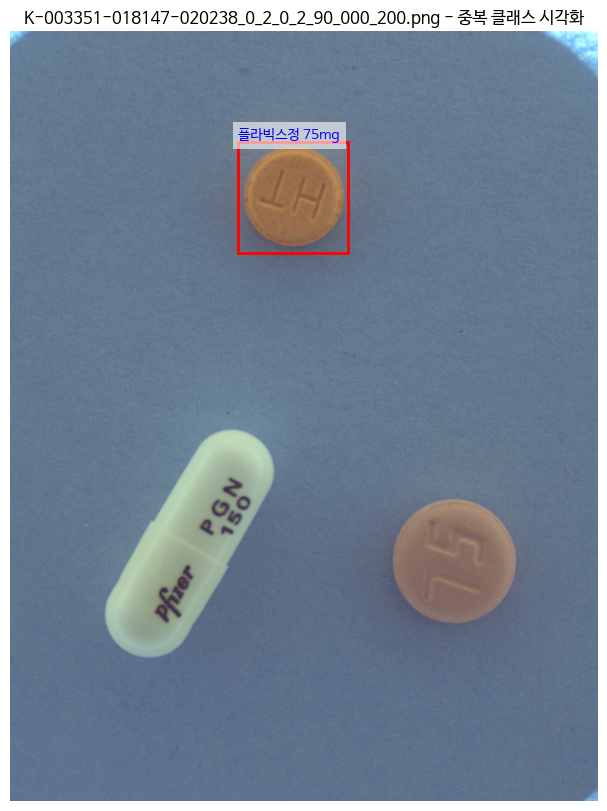

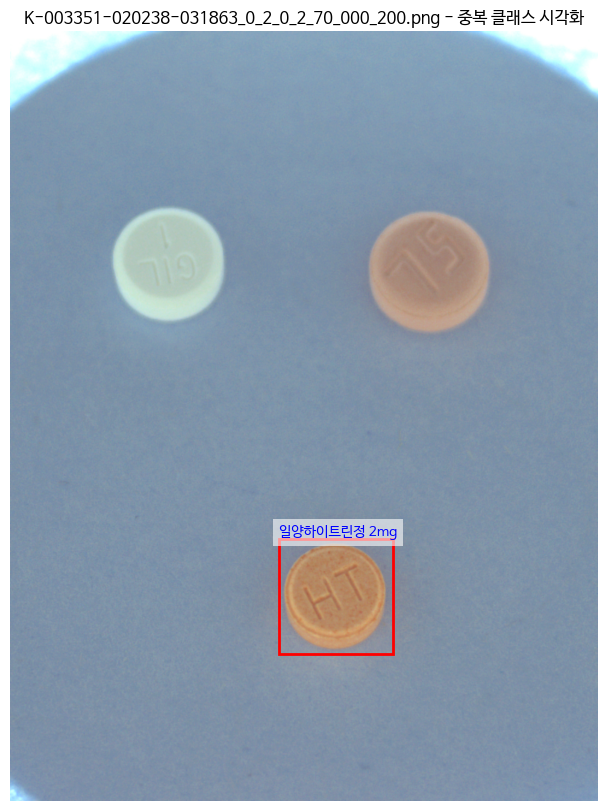

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import os

# 이미지 폴더 경로를 올바르게 수정!
IMAGE_ROOT = "/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images"



# 시각화 대상 바운딩 박스
targets = [
    ("K-003351-018147-020238_0_2_0_2_90_000_200.png", 379, 184),
    ("K-003351-020238-031863_0_2_0_2_70_000_200.png", 446, 844)
]

def visualize_conflict_boxes(df, targets):
    for file_name, x_val, y_val in targets:
        image_path = os.path.join(IMAGE_ROOT, file_name)

        if not os.path.exists(image_path):
            print(f" 이미지 없음: {image_path}")
            continue

        image = Image.open(image_path)
        fig, ax = plt.subplots(1, figsize=(10, 10))
        ax.imshow(image)

        # 해당 위치 바운딩 박스만 추출
        boxes = df[
            (df["file_name"] == file_name) &
            (df["bbox_x"] == x_val) &
            (df["bbox_y"] == y_val)
        ]

        for _, row in boxes.iterrows():
            x, y, w, h = int(row["bbox_x"]), int(row["bbox_y"]), int(row["bbox_w"]), int(row["bbox_h"])
            label = row["class_name"]

            rect = patches.Rectangle((x, y), w, h, linewidth=2, edgecolor='red', facecolor='none')
            ax.add_patch(rect)
            ax.text(x, y - 5, label, fontsize=10, color="blue",
                    bbox=dict(facecolor='white', alpha=0.6, edgecolor='none'))

        plt.title(f"{file_name} - 중복 클래스 시각화")
        plt.axis("off")
        plt.show()

# 실행
visualize_conflict_boxes(train_annotations_df, targets)


중복된 bbox = 일양하이트린정이므로 플라빅스정 제거 필요

In [ ]:
wrong_label = (
    (train_annotations_df['file_name'] == "K-003351-018147-020238_0_2_0_2_90_000_200.png") &
    (train_annotations_df['bbox_x'] == 379) &
    (train_annotations_df['bbox_y'] == 184) &
    (train_annotations_df['class_name'] == "플라빅스정 75mg")
)
train_annotations_df = train_annotations_df[~wrong_label]


In [ ]:
wrong_label = (
    (train_annotations_df['file_name'] == "K-003351-020238-031863_0_2_0_2_70_000_200.png") &
    (train_annotations_df['bbox_x'] == 446) &
    (train_annotations_df['bbox_y'] == 844) &
    (train_annotations_df['class_name'] == "플라빅스정 75mg")
)

# 제거
train_annotations_df = train_annotations_df[~wrong_label]
print("잘못된 중복 라벨 제거 완료!")


잘못된 중복 라벨 제거 완료!


In [ ]:
print(f"전체 어노테이션 수: {len(train_annotations_df)}")

전체 어노테이션 수: 1873


1876-> bbox 이상치 제거 후 저장 -> 1873개 (전체 annotations 수) [이미지 벗어나는 bbox 1개 제거, 중복 라벨 2개 제거]

이미지 중 annotations 없는 경우 확인하기

In [ ]:
print("image_id 기준 고유 이미지 수:", train_annotations_df['image_id'].nunique())


image_id 기준 고유 이미지 수: 1157


이미지 누락 확인

In [ ]:
import os

# 실제 존재하는 이미지 파일 이름 목록
all_image_paths = set(os.listdir(TRAIN_IMAGE_DIR))

# 어노테이션에서 사용된 파일 이름 목록
df_image_files = set(train_annotations_df['file_name'].unique())

# 누락된 이미지 파일 찾기
missing_images = df_image_files - all_image_paths

# 결과 출력
print(f"어노테이션에 있지만 실제 파일이 없는 이미지 수: {len(missing_images)}")
if missing_images:
    print("누락된 파일 목록:")
    for fname in sorted(missing_images):
        print(fname)
else:
    print("모든 이미지가 정상적으로 존재합니다 ")

어노테이션에 있지만 실제 파일이 없는 이미지 수: 0
모든 이미지가 정상적으로 존재합니다 


In [ ]:
train_annotations_df.describe()

,image_id,width,height,category_id,bbox_x,bbox_y,bbox_w,bbox_h
count,1873.000000,1873.0,1873.0,1873.000000,1873.000000,1873.000000,1873.000000,1873.000000
mean,751.205553,976.0,1280.0,17578.072077,352.870262,479.618793,259.314469,288.588361
std,432.300358,0.0,0.0,11667.129902,240.246318,306.286564,70.073229,116.895946
min,2.000000,976.0,1280.0,1899.000000,0.000000,0.000000,125.000000,125.000000
25%,378.000000,976.0,1280.0,3543.000000,121.000000,190.000000,209.000000,200.000000
50%,753.000000,976.0,1280.0,18146.000000,361.000000,322.000000,241.000000,230.000000
75%,1124.000000,976.0,1280.0,27732.000000,599.000000,798.000000,293.000000,401.000000
max,1500.000000,976.0,1280.0,44198.000000,690.000000,932.000000,529.000000,669.000000


category_id를 새로운 label_idx로 매핑 (편의 위함)

In [ ]:
import os
import json
import pandas as pd

# ✅ 정확한 CSV 경로 반영
csv_path = "/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_aug_uniform.csv"
df = pd.read_csv(csv_path)

# ✅ category_id 기준 고유값 추출
unique_category_ids = sorted(df["category_id"].dropna().unique().tolist())

# ✅ category_id → label_idx 매핑
label_map = {int(cat_id): idx for idx, cat_id in enumerate(unique_category_ids)}

# ✅ 저장 경로 설정
save_dir = "/content/drive/MyDrive/초급 프로젝트 데이터 모음"
os.makedirs(save_dir, exist_ok=True)
save_path = os.path.join(save_dir, "label_map.json")

# ✅ 매핑 정보 저장
with open(save_path, "w", encoding="utf-8") as f:
    json.dump(label_map, f, ensure_ascii=False, indent=4)

# ✅ 확인 메시지 출력
print(f"✅ 총 {len(unique_category_ids)}개의 고유 클래스를 발견했습니다.")
print(f"✅ 라벨 매핑 정보를 저장했습니다: {save_path}")


✅ 총 73개의 고유 클래스를 발견했습니다.
✅ 라벨 매핑 정보를 저장했습니다: /content/drive/MyDrive/초급 프로젝트 데이터 모음/label_map.json


# train_image와 매치되는 annotations 안의 bbox, 클래스 이름 시각화

In [ ]:
import glob

# 내 드라이브 전체에서 train_annotations 폴더 검색


matches = glob.glob("/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_annotations/**/*.json", recursive=True)

, recursive=True)
print(matches)


['/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_annotations/K-001900-010224-016551-031705_json/K-001900/K-001900-010224-016551-031705_0_2_0_2_70_000_200.json', '/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_annotations/K-001900-010224-016551-031705_json/K-001900/K-001900-010224-016551-031705_0_2_0_2_75_000_200.json', '/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_annotations/K-001900-010224-016551-031705_json/K-001900/K-001900-010224-016551-031705_0_2_0_2_90_000_200.json', '/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_annotations/K-001900-010224-016551-031705_json/K-016551/K-001900-010224-016551-031705_0_2_0_2_75_000_200.json', '/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_annotations/K-001900-010224-016551-031705_json/K-016551/K-001900-010224-016551-031705_0_2_0_2_90_000_200.json', '/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_annotations/K-001900-010224-016551-031705_json/K-016551/K-001900-010224-016551-031705_0_2_0_2_70_000_200.json', '/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_annotations/

In [ ]:
# 1. 나눔폰트 설치
!apt-get -qq install -y fonts-nanum

# 2. 런타임에 폰트 경로 등록
import matplotlib.font_manager as fm
import matplotlib.pyplot as plt
import matplotlib as mpl

# 3. 나눔폰트 강제 등록
font_path = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf'
fm.fontManager.addfont(font_path)
font_name = fm.FontProperties(fname=font_path).get_name()

# 4. matplotlib 기본 폰트로 설정
mpl.rc('font', family=font_name)
mpl.rcParams['axes.unicode_minus'] = False  # 마이너스 깨짐 방지


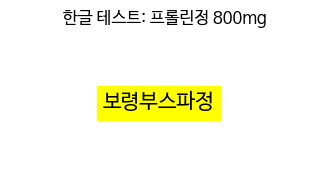

In [ ]:
plt.figure(figsize=(4, 2))
plt.title("한글 테스트: 프롤린정 800mg")
plt.text(0.3, 0.5, "보령부스파정", fontsize=15, color='black', backgroundcolor='yellow')
plt.axis('off')
plt.show()


In [ ]:
from matplotlib import font_manager as fm

# 먼저 한 번 폰트 경로 설정 (이미 했으면 생략 가능)
font_path = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf'
font_prop = fm.FontProperties(fname=font_path, size=10)


발견된 json 파일 수: 4526


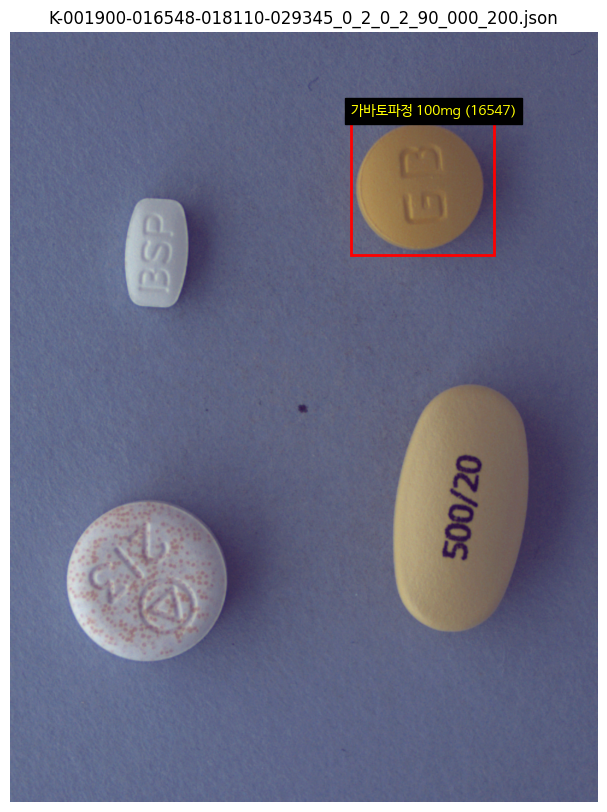

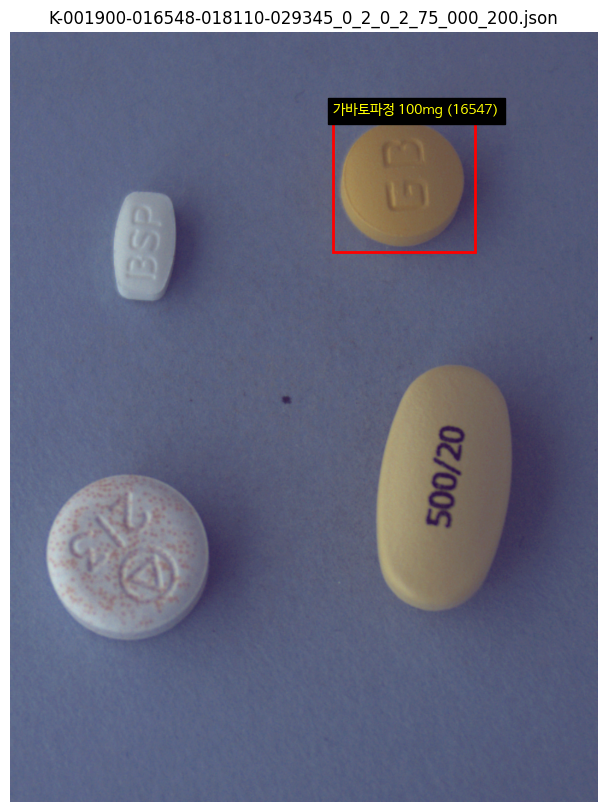

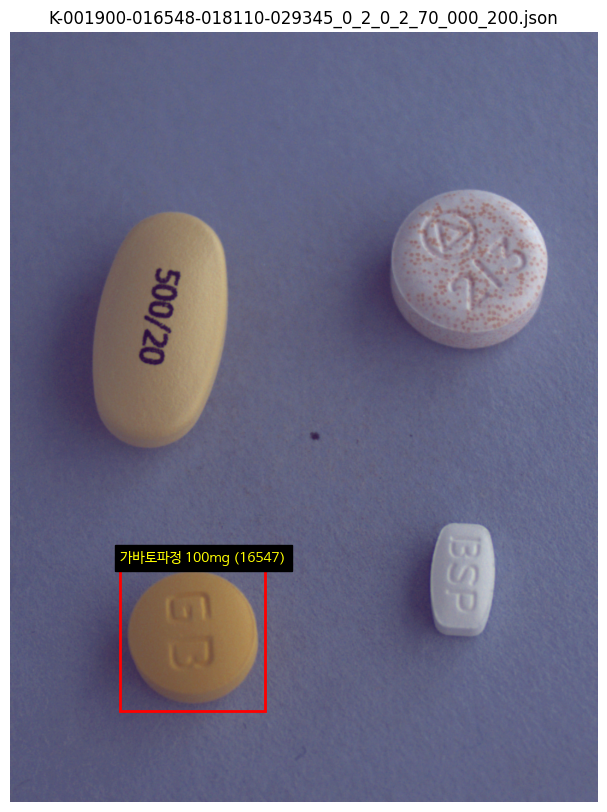

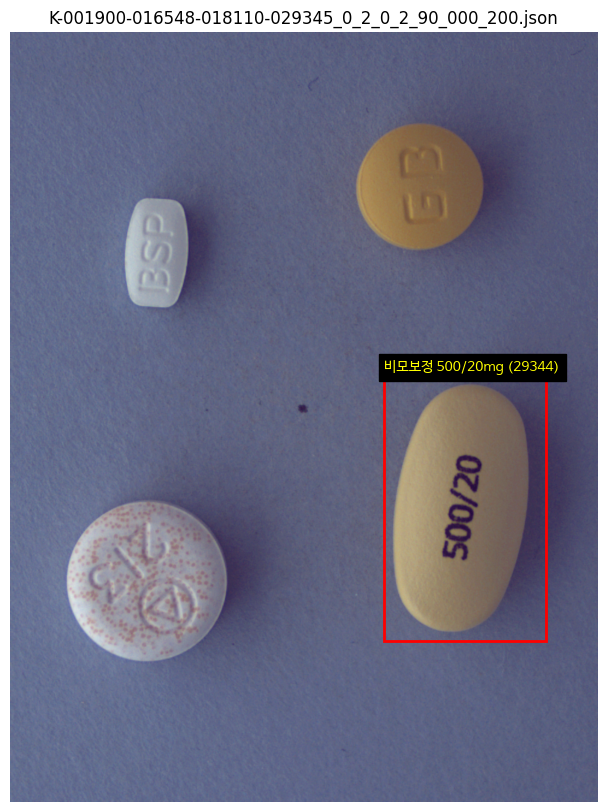

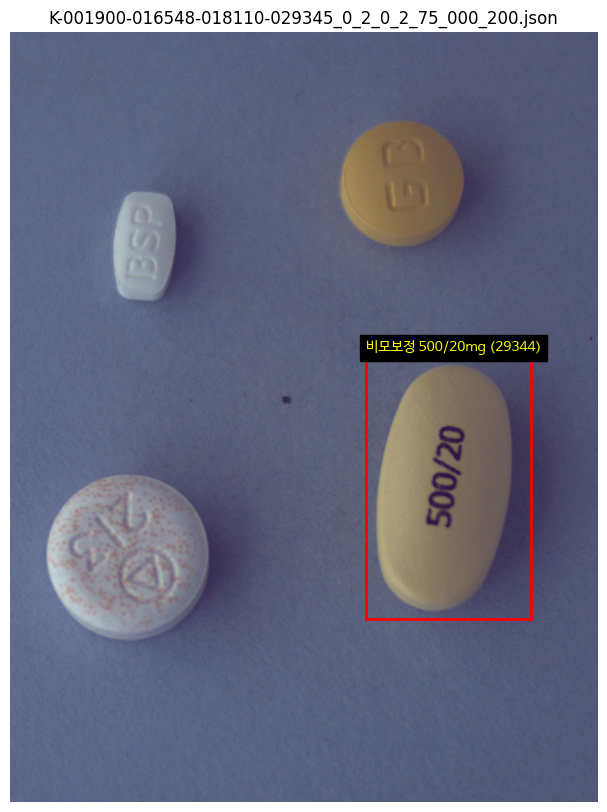

In [ ]:
import os
import json
import cv2
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle

# ✅ 정확한 경로로 수정
json_root_dir = '/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_annotations'
image_dir = '/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images'



plt.rcParams['font.family'] = 'DejaVu Sans'

# 3단계 구조 순회하며 .json 파일 수집
json_paths = []
for dir1 in os.listdir(json_root_dir):
    dir1_path = os.path.join(json_root_dir, dir1)
    if not os.path.isdir(dir1_path):
        continue
    for dir2 in os.listdir(dir1_path):
        dir2_path = os.path.join(dir1_path, dir2)
        if not os.path.isdir(dir2_path):
            continue
        for filename in os.listdir(dir2_path):
            if filename.endswith('.json'):
                json_paths.append(os.path.join(dir2_path, filename))

print(f'발견된 json 파일 수: {len(json_paths)}')

# 시각화 시작
max_samples = 5
shown = 0

for json_path in json_paths:
    with open(json_path, 'r') as f:
        data = json.load(f)

    images = data.get('images', [])
    annotations = data.get('annotations', [])
    categories = data.get('categories', [])

    if not images or not annotations:
        continue

    image_info = images[0]
    file_name = image_info['file_name']
    width = image_info['width']
    height = image_info['height']

    image_path = os.path.join(image_dir, file_name)
    if not os.path.exists(image_path):
        print(f'[경고] 이미지 없음: {file_name}')
        continue

    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    category_map = {cat['id']: cat['name'] for cat in categories}

    fig, ax = plt.subplots(1, figsize=(10, 10))
    ax.imshow(image)
    ax.set_title(f"{os.path.basename(json_path)}")

    for ann in annotations:
        bbox = ann.get('bbox', [])
        category_id = ann.get('category_id')
        class_name = category_map.get(category_id, 'unknown')

        if len(bbox) != 4:
            print(f"[경고] 잘못된 bbox: {bbox} in {json_path}")
            continue

        x, y, w, h = bbox
        if x < 0 or y < 0 or x + w > width or y + h > height:
            print(f"[경고] bbox 범위 벗어남: {bbox} in {json_path}")

        rect = Rectangle((x, y), w, h, linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        ax.text(
    x, y - 5,
    f"{class_name} ({category_id})",
    fontproperties=font_prop,  # ✅ 한글 폰트 직접 지정
    color='yellow',
    fontsize=10,
    backgroundcolor='black'
)



    plt.axis('off')
    plt.show()

    shown += 1
    if shown >= max_samples:
        break


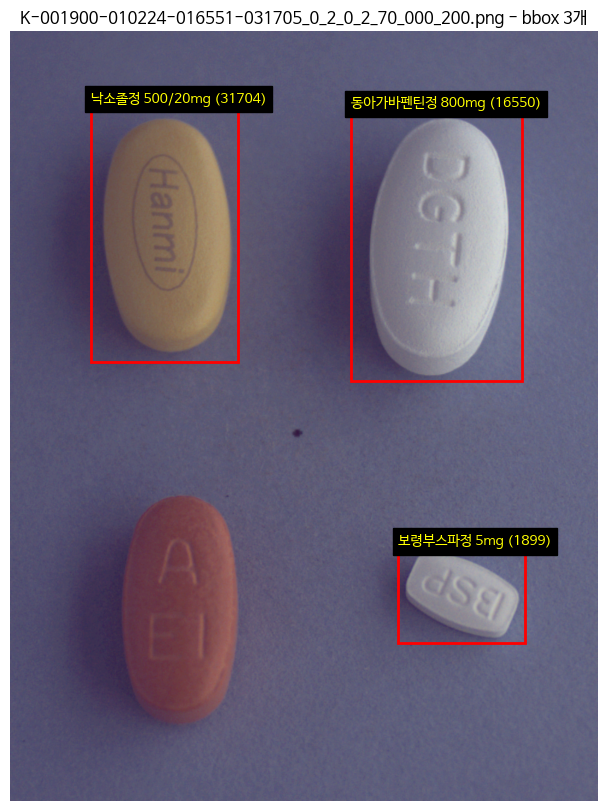

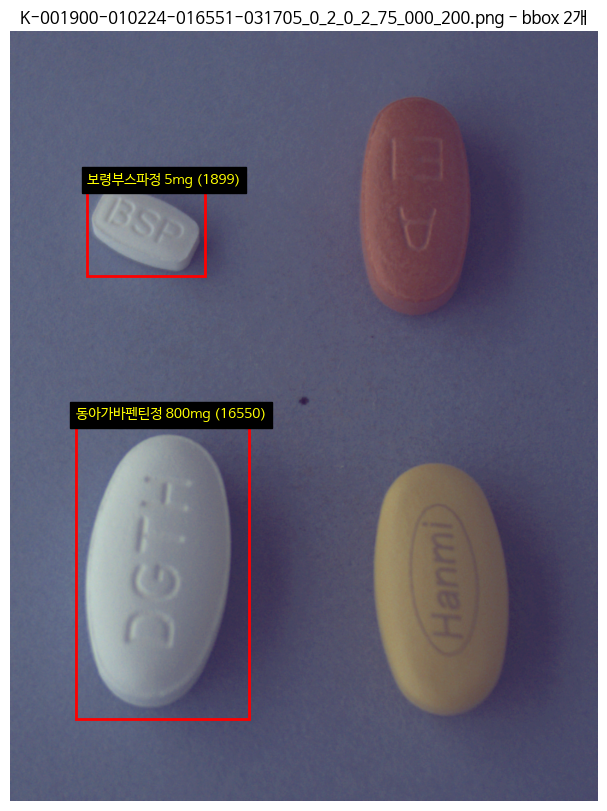

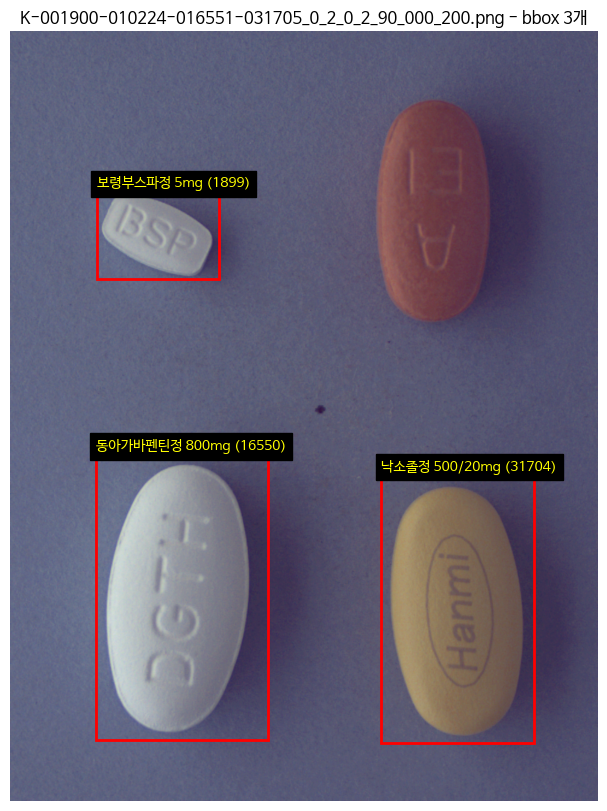

In [ ]:
import os
import json
import cv2
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from matplotlib import font_manager as fm
from collections import defaultdict

# 설정

json_root_dir = '/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_annotations'
image_dir = '/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images'


# 폰트
font_path = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf'
font_prop = fm.FontProperties(fname=font_path)
plt.rcParams['font.family'] = font_prop.get_name()

# ✅ 1. 특정 _json 폴더를 지정 (하나의 이미지 기준으로 묶여 있음)
target_folder = 'K-001900-010224-016551-031705_json'
target_folder_path = os.path.join(json_root_dir, target_folder)

# ✅ 2. 이 하위의 모든 .json 파일 로드
annotations_by_image = defaultdict(list)
image_info_by_file = dict()
category_map = dict()

for dir2 in os.listdir(target_folder_path):
    dir2_path = os.path.join(target_folder_path, dir2)
    if not os.path.isdir(dir2_path):
        continue

    for file in os.listdir(dir2_path):
        if not file.endswith('.json'):
            continue
        json_path = os.path.join(dir2_path, file)

        with open(json_path, 'r') as f:
            data = json.load(f)

        images = data.get('images', [])
        annotations = data.get('annotations', [])
        categories = data.get('categories', [])

        if not images or not annotations:
            continue

        image_info = images[0]
        file_name = image_info['file_name']
        image_info_by_file[file_name] = image_info
        category_map.update({cat['id']: cat['name'] for cat in categories})
        annotations_by_image[file_name].extend(annotations)

# ✅ 3. 하나의 이미지에 대해 모든 bbox를 시각화
for file_name, annotations in annotations_by_image.items():
    image_path = os.path.join(image_dir, file_name)
    if not os.path.exists(image_path):
        print(f"이미지 없음: {file_name}")
        continue

    image_info = image_info_by_file[file_name]
    width, height = image_info['width'], image_info['height']

    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    fig, ax = plt.subplots(1, figsize=(10, 10))
    ax.imshow(image)
    ax.set_title(f"{file_name} - bbox {len(annotations)}개")

    for ann in annotations:
        bbox = ann.get('bbox', [])
        category_id = ann.get('category_id')
        class_name = category_map.get(category_id, 'unknown')

        if len(bbox) != 4:
            continue
        x, y, w, h = bbox
        rect = Rectangle((x, y), w, h, linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        ax.text(
            x, y - 5,
            f"{class_name} ({category_id})",
            fontproperties=font_prop,
            color='yellow',
            fontsize=10,
            backgroundcolor='black'
        )

    plt.axis('off')
    plt.show()


In [ ]:
import os

# 경로 설정

image_dir = '/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images'



# 이미지 파일 확장자 기준으로 고유 이름 수 카운트
image_files = [f for f in os.listdir(image_dir) if f.endswith('.png')]
unique_image_count = len(set(image_files))

print(f"📸 train_images 안의 고유 이미지 수: {unique_image_count}")


📸 train_images 안의 고유 이미지 수: 1489


In [ ]:
import os
import json
import unicodedata
from pathlib import Path
from tqdm import tqdm

# 경로 설정
from pathlib import Path

# 경로 설정
json_root_dir = Path('/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_annotations')
image_dir = Path('/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images')


# 유니코드 정규화 함수
def normalize(filename):
    return unicodedata.normalize('NFC', filename.strip())

# ✅ 실제 이미지 목록 수집
actual_images = {normalize(p.name) for p in image_dir.glob("*.png")}

# ✅ 어노테이션에서 등장한 이미지 수집 (진행률 표시)
annotated_images = set()
lvl1_dirs = sorted([d for d in json_root_dir.iterdir() if d.is_dir()])

for lvl1 in tqdm(lvl1_dirs, desc="📂 L1 폴더 탐색"):
    lvl2_dirs = sorted([d for d in lvl1.iterdir() if d.is_dir()])
    for lvl2 in lvl2_dirs:
        json_files = list(lvl2.glob("*.json"))
        for json_file in json_files:
            try:
                with open(json_file, 'r', encoding='utf-8') as f:
                    data = json.load(f)
                images = data.get("images", [])
                if images:
                    fname = normalize(images[0]["file_name"])
                    annotated_images.add(fname)
            except Exception as e:
                print(f"❌ JSON 파싱 오류: {json_file.name} — {e}")

# ✅ 어노테이션에 없는 이미지 찾기
missing_from_annotation = actual_images - annotated_images

# ✅ 결과 출력
print(f"\n🟨 어노테이션이 없는 train_images 내 이미지 수: {len(missing_from_annotation)}")
if missing_from_annotation:
    print("예시:")
    print(list(missing_from_annotation)[:10])  # 예시 10개만 출력


📂 L1 폴더 탐색:   3%|▎         | 16/498 [00:48<24:13,  3.02s/it]


KeyboardInterrupt: 

바운딩 박스없는 train image 수 : 7개

#어노테이션 없는 7개 이미지 삭제

In [ ]:
import os

images_to_delete = [
    'K-003351-018357-036637_0_2_0_2_90_000_200 (1).png',
    'K-003351-018357-038162_0_2_0_2_70_000_200 (1).png',
    'K-003351-018357-038162_0_2_0_2_75_000_200 (1).png',
    'K-003351-019232-020238_0_2_0_2_70_000_200 (1).png',
    'K-003351-018357-036637_0_2_0_2_70_000_200 (1).png',
    'K-003351-018357-036637_0_2_0_2_75_000_200 (1).png',
    'K-003351-018357-038162_0_2_0_2_90_000_200 (1).png'
]

image_dir = Path('/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images')


for img_name in images_to_delete:
    img_path = os.path.join(image_dir, img_name)
    if os.path.exists(img_path):
        os.remove(img_path)
        print(f"🗑️ 삭제 완료: {img_name}")
    else:
        print(f"⚠️ 존재하지 않음: {img_name}")


⚠️ 존재하지 않음: K-003351-018357-036637_0_2_0_2_90_000_200 (1).png
⚠️ 존재하지 않음: K-003351-018357-038162_0_2_0_2_70_000_200 (1).png
⚠️ 존재하지 않음: K-003351-018357-038162_0_2_0_2_75_000_200 (1).png
⚠️ 존재하지 않음: K-003351-019232-020238_0_2_0_2_70_000_200 (1).png
⚠️ 존재하지 않음: K-003351-018357-036637_0_2_0_2_70_000_200 (1).png
⚠️ 존재하지 않음: K-003351-018357-036637_0_2_0_2_75_000_200 (1).png
⚠️ 존재하지 않음: K-003351-018357-038162_0_2_0_2_90_000_200 (1).png


In [ ]:
import os
image_dir = Path('/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images')


print(f"📷 현재 train_images 내 이미지 개수: {len(image_files)}")


📷 현재 train_images 내 이미지 개수: 1489


총 이미지 수 : 1489개

# annotations - 이미지 파일 간의 bbox, 라벨 이상치 제거

✅ train_annotations_df 기준 검출기 코드 (이미지 png와 대응)

In [ ]:
def get_bbox_count_range(annotations_df):
    """
    이미지당 바운딩 박스 개수의 최소값과 최대값을 반환

    Args:
        annotations_df (pd.DataFrame): train_annotations_df

    Returns:
        min_count (int), max_count (int)
    """
    bbox_counts = annotations_df.groupby("file_name").size()
    min_count = bbox_counts.min()
    max_count = bbox_counts.max()
    return min_count, max_count


In [ ]:
min_bbox, max_bbox = get_bbox_count_range(train_annotations_df)

print(f"✅ 이미지 1장당 바운딩 박스 개수 범위:")
print(f" - 최소: {min_bbox}개")
print(f" - 최대: {max_bbox}개")


✅ 이미지 1장당 바운딩 박스 개수 범위:
 - 최소: 1개
 - 최대: 4개


In [ ]:
import pandas as pd

def detect_missing_bboxes(train_annotations_df, min_valid_bboxes=3):
    """
    바운딩 박스가 누락된 이미지 검출기

    Args:
        train_annotations_df (pd.DataFrame): 어노테이션 정보
        min_valid_bboxes (int): 유효한 bbox 개수가 이보다 작으면 의심

    Returns:
        suspicious_df (pd.DataFrame): 누락 의심 이미지 정보
    """

    # 유효 bbox만 필터링 (너무 작거나 없는 bbox 제거)
    df_valid = train_annotations_df[
        (train_annotations_df['bbox_w'] > 1) &
        (train_annotations_df['bbox_h'] > 1)
    ]

    # 이미지별 bbox 개수 세기
    bbox_counts = df_valid.groupby('file_name').size().reset_index(name='bbox_count')

    # bbox 개수가 기준보다 적은 이미지 찾기
    suspicious_df = bbox_counts[bbox_counts['bbox_count'] < min_valid_bboxes].copy()

    return suspicious_df


In [ ]:
import os

# 디렉터리가 없다면 생성
output_dir = "/content/drive/MyDrive/초급 프로젝트 데이터 모음/output_viz"
os.makedirs(output_dir, exist_ok=True)

# CSV로 저장
suspicious_images_df.to_csv(
    f"{output_dir}/missing_bbox_images.csv",
    index=False
)


NameError: name 'suspicious_images_df' is not defined

In [ ]:
# 누락 의심 이미지 검출 (bbox 3개 미만인 경우)
suspicious_images_df = detect_missing_bboxes(train_annotations_df, min_valid_bboxes=3)

print(f"🔍 바운딩 박스 누락 의심 이미지 수: {len(suspicious_images_df)}개\n")

# 상위 10개 확인
print(suspicious_images_df.head(10))

# 필요하면 CSV로 저장
# 필요하면 CSV로 저장
suspicious_images_df.to_csv(
    "/content/drive/MyDrive/초급 프로젝트 데이터 모음/output_viz/missing_bbox_images.csv",
    index=False
)


🔍 바운딩 박스 누락 의심 이미지 수: 1027개

                                            file_name  bbox_count
0   K-001900-010224-016551-031705_0_2_0_2_70_000_2...           1
1   K-001900-010224-016551-031705_0_2_0_2_75_000_2...           1
2   K-001900-010224-016551-031705_0_2_0_2_90_000_2...           1
3   K-001900-010224-016551-033009_0_2_0_2_70_000_2...           2
4   K-001900-010224-016551-033009_0_2_0_2_90_000_2...           1
6   K-001900-016548-018110-021026_0_2_0_2_75_000_2...           1
8   K-001900-016548-018110-027926_0_2_0_2_90_000_2...           1
9   K-001900-016548-018110-029345_0_2_0_2_70_000_2...           2
10  K-001900-016548-018110-029345_0_2_0_2_90_000_2...           2
12  K-001900-016548-018110-029451_0_2_0_2_90_000_2...           1


In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def visualize_sample_bboxes(sample_df, annotations_df, image_dir, sample_size=5):
    """
    bbox 누락 의심 이미지들 중 샘플 몇 장 시각화

    Args:
        sample_df (pd.DataFrame): suspicious_images_df (file_name, bbox_count)
        annotations_df (pd.DataFrame): train_annotations_df
        image_dir (str): 이미지 폴더 경로
        sample_size (int): 몇 장 시각화할지
    """
    sample_files = sample_df['file_name'].sample(n=sample_size, random_state=42).tolist()

    for file_name in sample_files:
        img_path = os.path.join(image_dir, file_name)

        # 이미지 열기
        image = cv2.imread(img_path)
        if image is None:
            print(f"⚠ 이미지 불러오기 실패: {file_name}")
            continue
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # 해당 이미지의 바운딩 박스 가져오기
        boxes = annotations_df[annotations_df['file_name'] == file_name][['bbox_x', 'bbox_y', 'bbox_w', 'bbox_h']].values

        # 시각화
        fig, ax = plt.subplots(1, figsize=(8, 10))
        ax.imshow(image)
        ax.set_title(f"{file_name} — bbox 개수: {len(boxes)}", fontsize=12)

        for box in boxes:
            x, y, w, h = box
            rect = patches.Rectangle((x, y), w, h, linewidth=2, edgecolor='red', facecolor='none')
            ax.add_patch(rect)

        plt.axis("off")
        plt.tight_layout()
        plt.show()


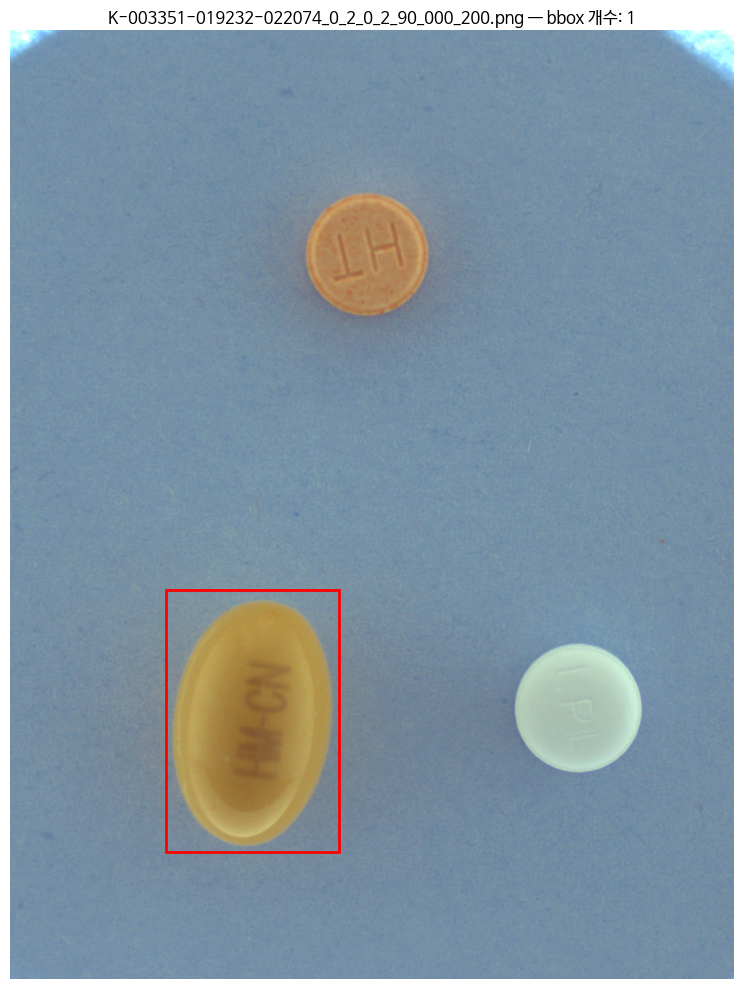

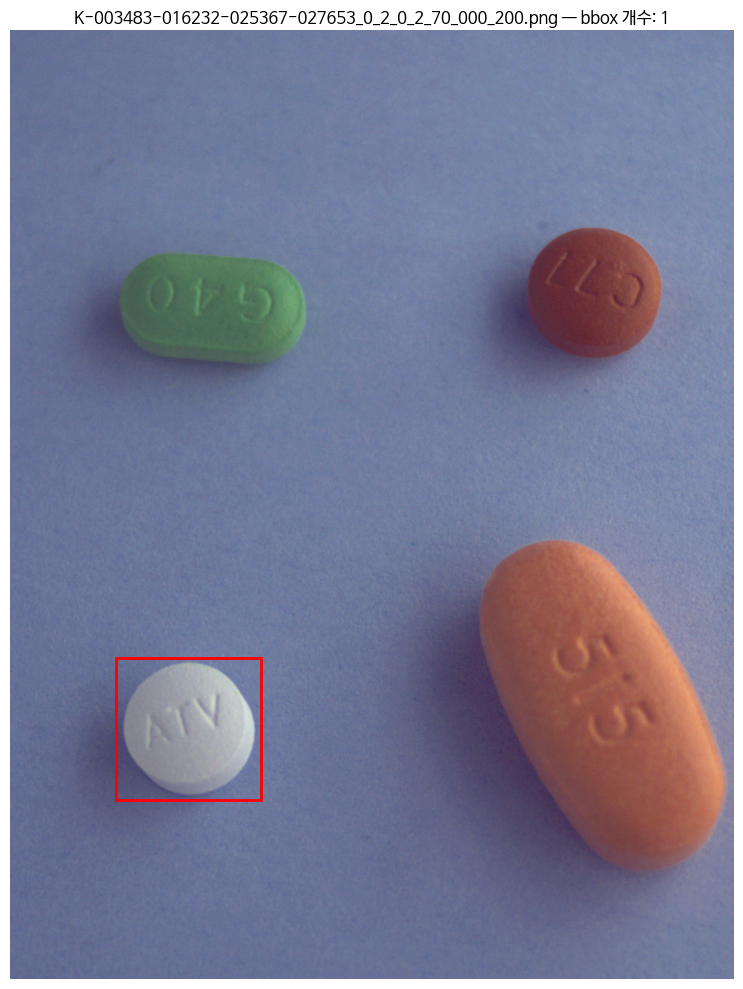

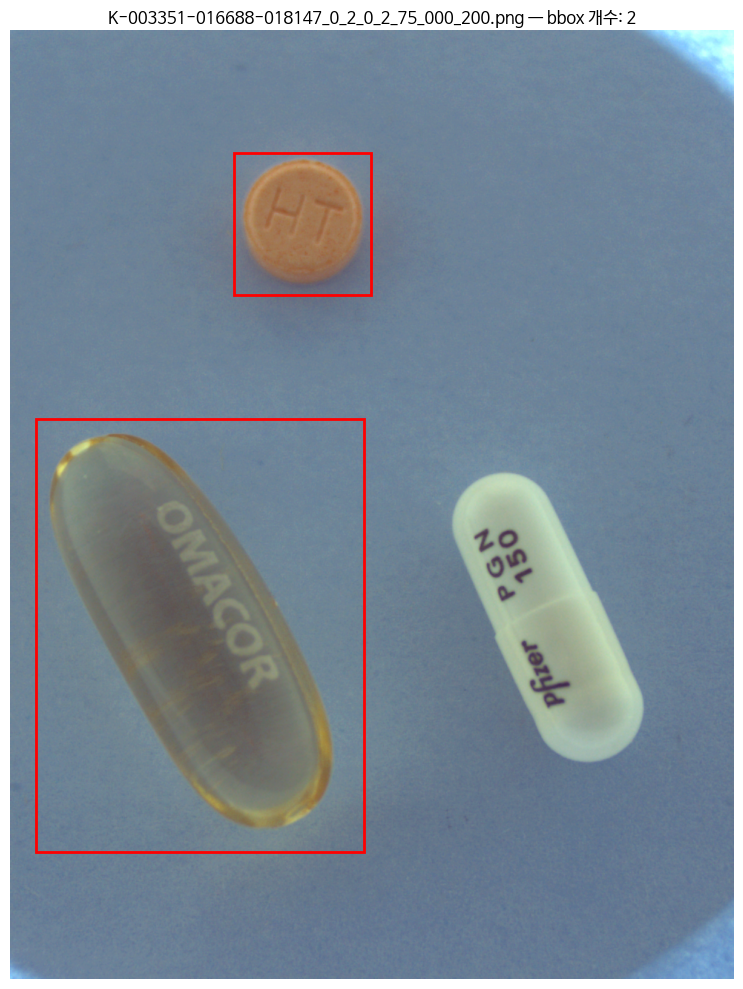

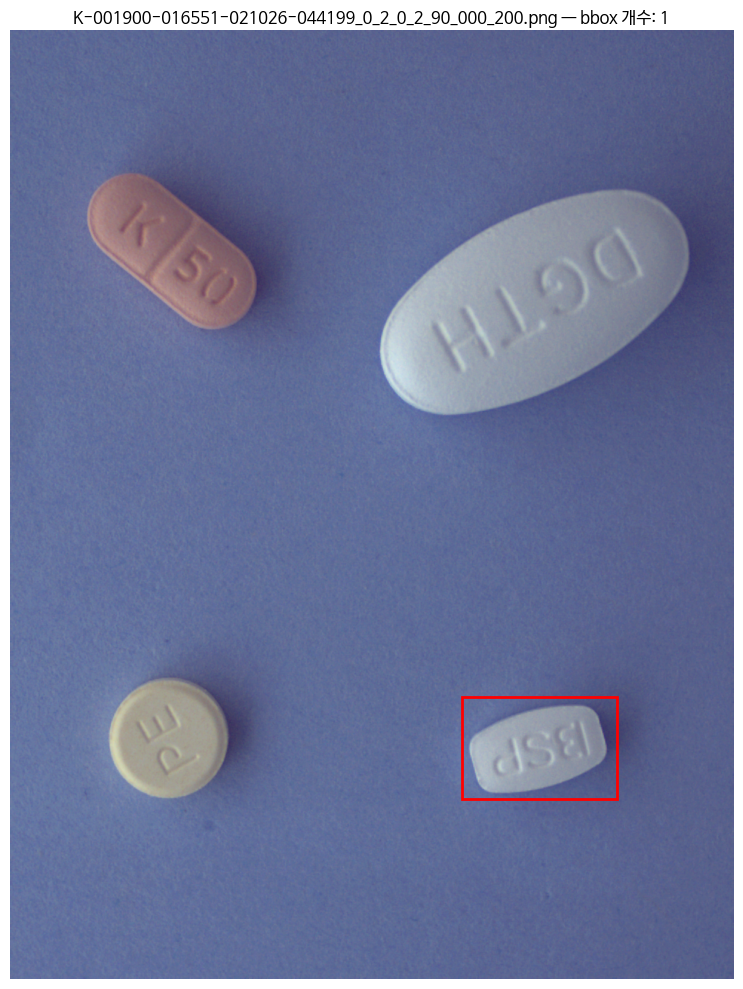

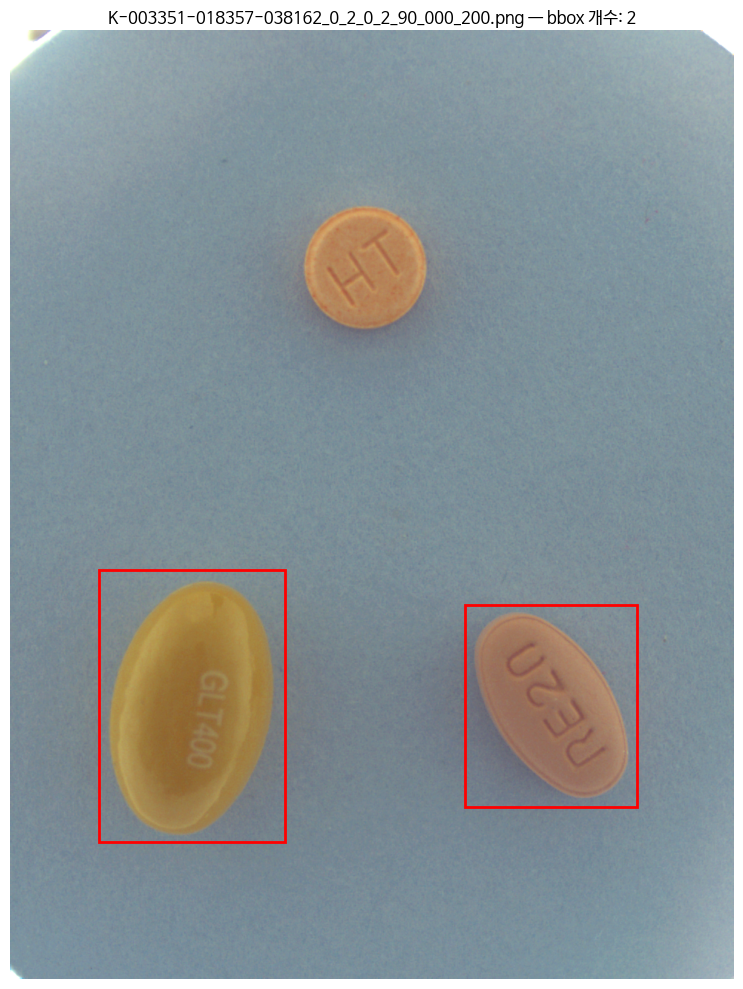

In [ ]:
visualize_sample_bboxes(
    sample_df=suspicious_images_df,
    annotations_df=train_annotations_df,
    image_dir = Path('/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images'),
    sample_size=5
)


#바운딩 박스 1개인 이미지 삭제하기

In [ ]:
# 이미지별 바운딩 박스 개수 세기
bbox_counts = train_annotations_df.groupby("file_name").size().reset_index(name="bbox_count")

# 바운딩 박스가 1개인 이미지만 필터링
one_bbox_df = bbox_counts[bbox_counts["bbox_count"] == 1]

# 총 개수 출력
print(f"✅ 바운딩 박스가 1개인 이미지 수: {len(one_bbox_df)}개")

# 예시 5개 출력
print("\n🧾 예시 이미지 파일명:")
for fname in one_bbox_df["file_name"].head(5):
    print(f" - {fname}")


✅ 바운딩 박스가 1개인 이미지 수: 584개

🧾 예시 이미지 파일명:
 - K-001900-010224-016551-031705_0_2_0_2_70_000_200.png
 - K-001900-010224-016551-031705_0_2_0_2_75_000_200.png
 - K-001900-010224-016551-031705_0_2_0_2_90_000_200.png
 - K-001900-010224-016551-033009_0_2_0_2_90_000_200.png
 - K-001900-016548-018110-021026_0_2_0_2_75_000_200.png


In [ ]:
import matplotlib.pyplot as plt
import cv2
import random
import os

def visualize_bbox_one_images(df, image_dir, num_samples=9):
    """
    bbox가 1개인 이미지 중 랜덤으로 일부를 시각화

    Args:
        df (pd.DataFrame): 전체 train_annotations_df
        image_dir (str): 이미지가 있는 디렉토리
        num_samples (int): 시각화할 이미지 수
    """
    # 1. bbox 1개인 이미지 추출
    bbox_counts = df.groupby("file_name").size()
    one_bbox_imgs = bbox_counts[bbox_counts == 1].index.tolist()

    # 2. 무작위 샘플 선택
    sampled_imgs = random.sample(one_bbox_imgs, min(num_samples, len(one_bbox_imgs)))

    # 3. 시각화
    plt.figure(figsize=(15, 15))
    for idx, file_name in enumerate(sampled_imgs):
        image_path = os.path.join(image_dir, file_name)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # 해당 이미지의 바운딩 박스
        bbox = df[df["file_name"] == file_name][["bbox_x", "bbox_y", "bbox_w", "bbox_h"]].values[0]
        x, y, w, h = map(int, bbox)
        cv2.rectangle(image, (x, y), (x + w, y + h), color=(255, 0, 0), thickness=3)

        plt.subplot(3, 3, idx + 1)
        plt.imshow(image)
        plt.title(file_name, fontsize=8)
        plt.axis("off")

    plt.tight_layout()
    plt.show()


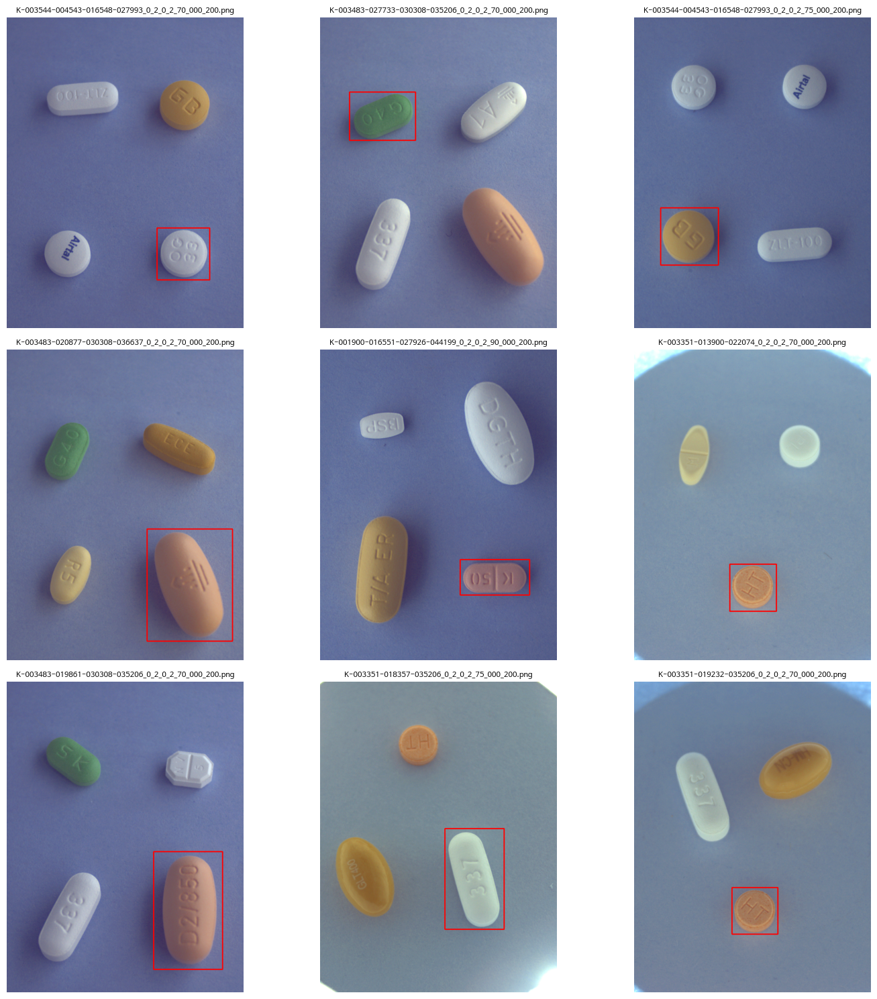

In [ ]:
# 예시 실행
visualize_bbox_one_images(train_annotations_df, image_dir = Path('/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images'))


In [ ]:
import os

# 이미지 디렉토리에서 전체 이미지 파일 수집
image_dir = Path('/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images')
all_images = {f for f in os.listdir(image_dir) if f.endswith('.png')}

# 어노테이션에 등장한 이미지들
annotated_images = set(train_annotations_df["file_name"].unique())

# 어노테이션 없는 이미지 수 확인
unannotated_images = all_images - annotated_images

print(f"📦 전체 이미지 수: {len(all_images)}장")
print(f"📄 어노테이션이 있는 이미지 수: {len(annotated_images)}장")
print(f"❌ 어노테이션이 **없는** 이미지 수: {len(unannotated_images)}장")


📦 전체 이미지 수: 1489장
📄 어노테이션이 있는 이미지 수: 1156장
❌ 어노테이션이 **없는** 이미지 수: 333장


In [ ]:
import matplotlib.pyplot as plt
import cv2
import os
import random

def visualize_unannotated_images(image_dir, unannotated_images, num_samples=9):
    """
    어노테이션 없는 이미지 시각화 + 예시 출력

    Args:
        image_dir (str): 이미지 디렉토리 경로
        unannotated_images (set): 어노테이션 없는 이미지 파일명 set
        num_samples (int): 시각화할 이미지 수
    """
    unannotated_list = sorted(list(unannotated_images))

    print(f"❌ 어노테이션 없는 이미지 수: {len(unannotated_list)}개")
    print("\n🧾 예시 이미지 파일명:")
    for fname in unannotated_list[:10]:
        print(f" - {fname}")

    # 랜덤 샘플 시각화
    sample_imgs = random.sample(unannotated_list, min(num_samples, len(unannotated_list)))

    plt.figure(figsize=(15, 15))
    for idx, fname in enumerate(sample_imgs):
        img_path = os.path.join(image_dir, fname)
        img = cv2.imread(img_path)
        if img is None:
            continue
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        plt.subplot(3, 3, idx + 1)
        plt.imshow(img)
        plt.title(fname, fontsize=8)
        plt.axis("off")
    plt.tight_layout()
    plt.show()


❌ 어노테이션 없는 이미지 수: 333개

🧾 예시 이미지 파일명:
 - K-001900-010224-016551-033009_0_2_0_2_75_000_200.png
 - K-001900-016548-018110-021026_0_2_0_2_90_000_200.png
 - K-001900-016548-018110-027926_0_2_0_2_70_000_200.png
 - K-001900-016548-018110-029345_0_2_0_2_75_000_200.png
 - K-001900-016548-018110-029451_0_2_0_2_75_000_200.png
 - K-001900-016548-018110-033009_0_2_0_2_75_000_200.png
 - K-001900-016548-019607-021026_0_2_0_2_75_000_200.png
 - K-001900-016548-019607-027926_0_2_0_2_70_000_200.png
 - K-001900-016548-019607-029345_0_2_0_2_70_000_200.png
 - K-001900-016548-019607-031705_0_2_0_2_75_000_200.png


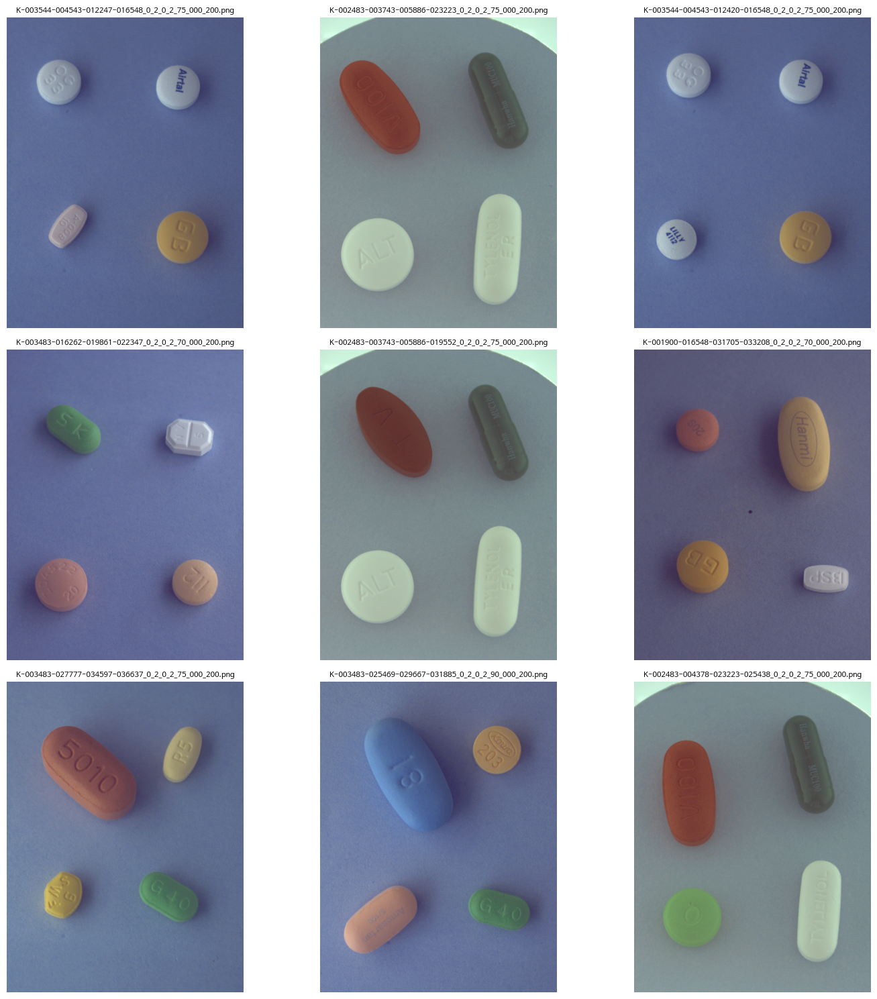

In [ ]:
# 기존 코드로 unannotated 이미지 구한 상태여야 함
# all_images = 이미지 디렉토리 기준 이미지 set
# annotated_images = train_annotations_df['file_name'].unique()

unannotated_images = all_images - annotated_images

visualize_unannotated_images(
    image_dir = '/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images',
    unannotated_images=unannotated_images,
    num_samples=9
)


# 정상 데이터 저장

bbox가 1개인 이미지 삭제하기

= 총 579개 (전체의 38.89%)  중에 실제 이미지에 알약이 1개인 경우 제외하고 삭제하기

20개씩 시각화 해서 확인 해봤는데 알약 개수는 대부분 3-4개임.  

bbox가 1개씩만 존재하는 이미지,annotations 파일은 삭제 필요

In [ ]:
import os

# 이미지 폴더 경로
image_dir = "/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images"

# 실제 이미지 파일명 목록 (확장자 포함)
all_images = set(os.listdir(image_dir))

# 어노테이션에서 사용된 이미지 파일명 목록
used_images = set(train_annotations_df["file_name"].unique())

# 어노테이션이 없는 이미지들 = 이미지 폴더에는 있는데, 어노테이션에는 없는 경우
no_annotation_images = sorted(all_images - used_images)

# 결과 출력
print(f"📂 전체 이미지 수: {len(all_images)}장")
print(f"✅ 어노테이션 있는 이미지 수: {len(used_images)}장")
print(f"❌ 어노테이션 없는 이미지 수: {len(no_annotation_images)}장")
print("예시:", no_annotation_images[:5])


📂 전체 이미지 수: 1489장
✅ 어노테이션 있는 이미지 수: 1157장
❌ 어노테이션 없는 이미지 수: 332장
예시: ['K-001900-010224-016551-033009_0_2_0_2_70_000_200.png', 'K-001900-016548-018110-027926_0_2_0_2_90_000_200.png', 'K-001900-016548-018110-029345_0_2_0_2_70_000_200.png', 'K-001900-016548-018110-033009_0_2_0_2_90_000_200.png', 'K-001900-016548-019607-027926_0_2_0_2_70_000_200.png']


#노테이션이 없는 이미지를 제외한 파일

In [ ]:
# 어노테이션 없는 이미지 목록 set으로 변환
no_ann_set = set(no_annotation_images)

# 어노테이션 있는 이미지 데이터만 필터링
train_annotations_filtered_df = train_annotations_df[~train_annotations_df['file_name'].isin(no_ann_set)].copy()

# 결과 저장
output_path = "/content/drive/MyDrive/초급 프로젝트 데이터 모음/output_viz"
os.makedirs(output_path, exist_ok=True)

train_annotations_filtered_df.to_csv(
    f"{output_path}/train_annotations_wo_no_annotation.csv",
    index=False
)


In [ ]:
import pandas as pd

# CSV 불러오기
filtered_df = pd.read_csv("/content/drive/MyDrive/초급 프로젝트 데이터 모음/output_viz/train_annotations_wo_no_annotation.csv")

# 고유 이미지 개수 출력
num_images = filtered_df['file_name'].nunique()
print(f"✅ 어노테이션 있는 이미지 수 (no_annotation 제외): {num_images}장")


✅ 어노테이션 있는 이미지 수 (no_annotation 제외): 1157장


In [ ]:
import pandas as pd
import os

# (1) 어노테이션 없는 이미지 목록: no_annotation_images (set 타입이라고 가정)
no_ann_set = set(no_annotation_images)

# (2) 어노테이션이 존재하는 파일만 필터링
filtered_df = train_annotations_df[~train_annotations_df['file_name'].isin(no_ann_set)].copy()

# (3) 이미지별 바운딩 박스 개수 세기
bbox_counts = filtered_df.groupby("file_name").size().reset_index(name="bbox_count")

# (4) 바운딩 박스가 1개인 이미지만 필터링
one_bbox_df = bbox_counts[bbox_counts["bbox_count"] == 1]
bbox_1_set = set(one_bbox_df["file_name"])

# (5) bbox가 1개인 이미지까지 제외한 최종 어노테이션
cleaned_df = filtered_df[~filtered_df['file_name'].isin(bbox_1_set)].copy()

# (6) 저장
output_path = "/content/drive/MyDrive/초급 프로젝트 데이터 모음/output_viz"
os.makedirs(output_path, exist_ok=True)

cleaned_df.to_csv(
    f"{output_path}/train_annotations_cleaned.csv",
    index=False
)

# (7) 확인 출력
print(f"✅ 최종 어노테이션 이미지 수: {cleaned_df['file_name'].nunique()}장")
print(f"📦 총 바운딩 박스 수: {len(cleaned_df)}개")

print("\n🧾 바운딩 박스 1개로 제외된 이미지 예시:")
for fname in list(bbox_1_set)[:5]:
    print(f" - {fname}")


✅ 최종 어노테이션 이미지 수: 563장
📦 총 바운딩 박스 수: 1279개

🧾 바운딩 박스 1개로 제외된 이미지 예시:
 - K-003483-016232-027653-031885_0_2_0_2_90_000_200.png
 - K-003483-016262-022347-027733_0_2_0_2_70_000_200.png
 - K-002483-003743-005886-022627_0_2_0_2_90_000_200.png
 - K-002483-005094-005886-019552_0_2_0_2_70_000_200.png
 - K-003483-025469-029667-030308_0_2_0_2_90_000_200.png


train_annotations_cleaned.csv: 전체 어노테이션에서 어노테이션이 없는 이미지에 해당하는 파일, 바운딩 박스가 1개인 이미지가 해당되는 파일을 제외한 정제된 데이터

In [ ]:
import os
import shutil
from tqdm import tqdm

# 1. 정제된 어노테이션 파일 불러오기
cleaned_df = pd.read_csv("/content/drive/MyDrive/초급 프로젝트 데이터 모음/output_viz/train_annotations_cleaned.csv")

# 2. 해당되는 이미지 목록 (중복 제거)
cleaned_image_list = cleaned_df['file_name'].unique()

# 3. 원본 이미지 폴더와 대상 폴더 설정
src_dir = "/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images"
dst_dir = "/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images_cleaned"
os.makedirs(dst_dir, exist_ok=True)

# 4. 이미지 복사
for fname in tqdm(cleaned_image_list, desc="📦 정제된 이미지 복사 중"):
    src_path = os.path.join(src_dir, fname)
    dst_path = os.path.join(dst_dir, fname)
    if os.path.exists(src_path):
        shutil.copy(src_path, dst_path)


📦 정제된 이미지 복사 중: 100%|██████████| 572/572 [00:21<00:00, 26.99it/s]


In [ ]:
import pandas as pd

# 1. 최신 train_annotations_df 사용
df = train_annotations_df.copy()

# 2. 이미지별 bbox 수 세기
bbox_counts = df.groupby("file_name").size().reset_index(name="bbox_count")

# 3. bbox가 1개인 이미지 목록 추출
one_bbox_images = bbox_counts[bbox_counts["bbox_count"] == 1]["file_name"].tolist()
print(f"❗ bbox가 1개인 이미지 수: {len(one_bbox_images)}개")

# 4. 해당 이미지 제거
df_cleaned = df[~df["file_name"].isin(one_bbox_images)].reset_index(drop=True)

# 5. 정제본 저장
df_cleaned.to_csv("train_df_cleaned.csv", index=False)
print("✅ train_df_cleaned.csv 저장 완료")

# 6. 확인 출력
print(f"📄 어노테이션 수: {len(df_cleaned)}개")
print(f"🖼 이미지 수: {df_cleaned['file_name'].nunique()}장")

# 7. bbox가 1개인 이미지가 남아있는지 최종 검증
bbox_check = df_cleaned.groupby("file_name").size().reset_index(name="bbox_count")
still_one_bbox = bbox_check[bbox_check["bbox_count"] == 1]

if len(still_one_bbox) == 0:
    print("🎉 bbox가 1개인 이미지 완벽 제거 완료!")
else:
    print(f"⚠️ 아직 bbox 1개 이미지가 {len(still_one_bbox)}개 남아 있음")
    print("예시:", still_one_bbox.head())


❗ bbox가 1개인 이미지 수: 584개
✅ train_df_cleaned.csv 저장 완료
📄 어노테이션 수: 1289개
🖼 이미지 수: 572장
🎉 bbox가 1개인 이미지 완벽 제거 완료!


train_annotations_cleaned.csv → 학습용 정제 데이터프레임

#바운딩 박스 2개인 이미지

✅ 바운딩 박스가 2개인 이미지 수: 443개

🧾 예시 이미지 파일명:
 - K-001900-010224-016551-033009_0_2_0_2_70_000_200.png
 - K-001900-016548-018110-029345_0_2_0_2_70_000_200.png
 - K-001900-016548-018110-029345_0_2_0_2_90_000_200.png
 - K-001900-016548-018110-031705_0_2_0_2_90_000_200.png
 - K-001900-016548-019607-021026_0_2_0_2_70_000_200.png


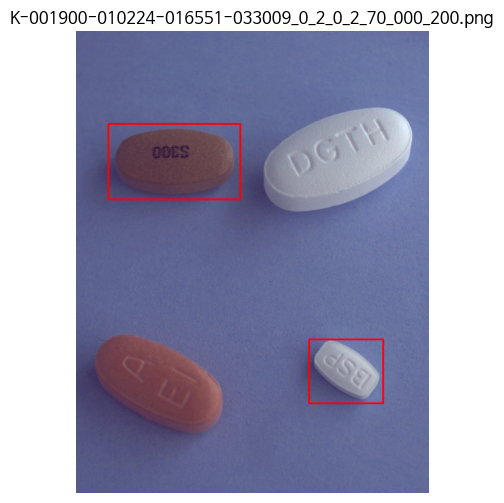

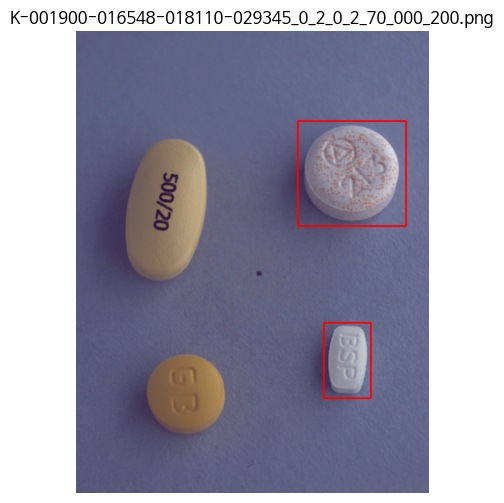

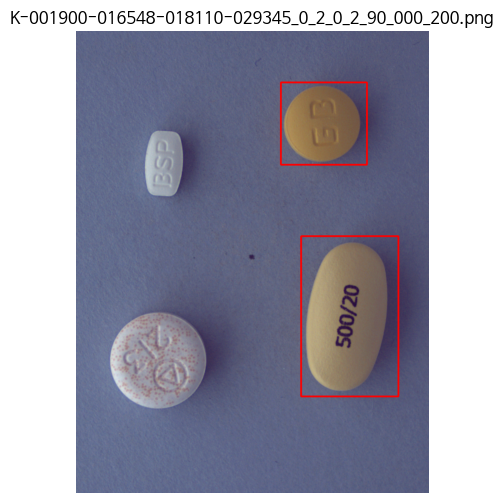

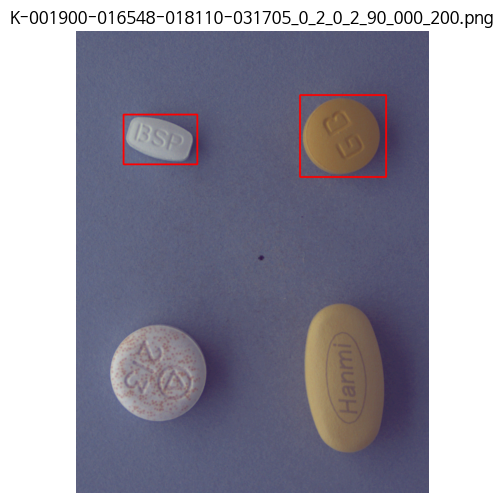

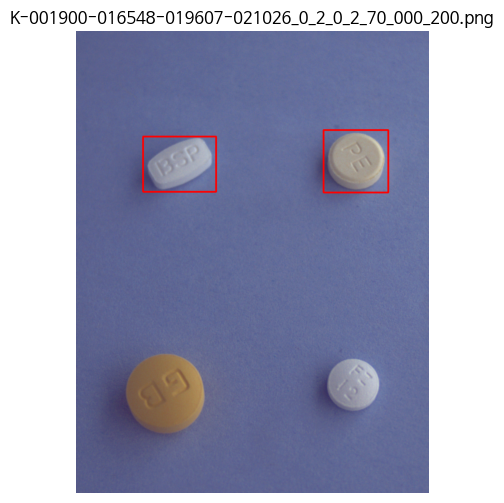

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import os

# DataFrame 복사
df = train_annotations_df.copy()

# 이미지별 바운딩 박스 개수 세기
bbox_counts = df.groupby("file_name").size().reset_index(name="bbox_count")

# 바운딩 박스가 2개인 이미지 필터링
two_bbox_df = bbox_counts[bbox_counts["bbox_count"] == 2]

# 총 개수 출력
print(f"✅ 바운딩 박스가 2개인 이미지 수: {len(two_bbox_df)}개")

# 예시 이미지 파일명 출력
print("\n🧾 예시 이미지 파일명:")
for fname in two_bbox_df["file_name"].head(5):
    print(f" - {fname}")

# 샘플 이미지 5개 추출
sample_files = two_bbox_df["file_name"].head(5).tolist()

# 이미지 루트 경로
image_root = "/content/drive/MyDrive/초급 프로젝트 데이터 모음/train_images"

# 시각화 함수 정의
def visualize_bboxes(df, file_list, image_root):
    for fname in file_list:
        path = os.path.join(image_root, fname)
        img = cv2.imread(path)
        if img is None:
            print(f"❌ 이미지 로드 실패: {fname}")
            continue
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # 해당 이미지의 바운딩 박스 정보 추출
        boxes = df[df["file_name"] == fname][["bbox_x", "bbox_y", "bbox_w", "bbox_h"]].values

        for (x, y, w, h) in boxes:
            x1, y1 = int(x), int(y)
            x2, y2 = int(x + w), int(y + h)
            cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 0), 3)

        plt.figure(figsize=(6, 6))
        plt.imshow(img)
        plt.title(fname)
        plt.axis("off")
        plt.show()

# 시각화 실행
visualize_bboxes(df, sample_files, image_root)


#ㅓㅓ

In [ ]:
import os
import json
import pandas as pd
from PIL import Image

def validate_annotations(
    json_dir, image_dir, annotations_df, label_map_path="./label_map.json"
):
    issues = []

    # label_map 불러오기
    with open(label_map_path, 'r', encoding='utf-8') as f:
        label_map = json.load(f)

    known_category_ids = set(map(int, label_map['id_to_idx'].keys()))

    # JSON 파일 순회
    for json_file in os.listdir(json_dir):
        if not json_file.endswith(".json"):
            continue

        json_path = os.path.join(json_dir, json_file)
        with open(json_path, 'r') as f:
            data = json.load(f)

        # 이미지 메타 정보 추출
        try:
            image_info = data['images'][0]
            file_name = image_info['file_name']
            image_id = image_info['id']
            width = image_info['width']
            height = image_info['height']
        except Exception:
            issues.append((json_file, "이미지 메타 정보 누락"))
            continue

        # 이미지 존재 여부
        image_path = os.path.join(image_dir, file_name)
        if not os.path.exists(image_path):
            issues.append((file_name, "이미지 파일 없음"))

        # 어노테이션 목록
        annotations = data.get("annotations", [])
        if len(annotations) == 0:
            issues.append((file_name, "annotations 비어 있음"))
            continue

        for ann in annotations:
            # bbox 검증
            bbox = ann.get("bbox", [])
            if not bbox or len(bbox) != 4:
                issues.append((file_name, "bbox 형식 오류"))
                continue
            x, y, w, h = bbox
            if w <= 0 or h <= 0:
                issues.append((file_name, f"bbox 크기 이상 (w={w}, h={h})"))
            if x < 0 or y < 0 or x + w > width or y + h > height:
                issues.append((file_name, f"bbox 이미지 범위 초과 (x={x}, y={y}, w={w}, h={h})"))

            # category_id 검증
            cat_id = ann.get("category_id")
            if cat_id is None:
                issues.append((file_name, "category_id 없음"))
            elif int(cat_id) not in known_category_ids:
                issues.append((file_name, f"category_id {cat_id}가 label_map에 없음"))

        # train_annotations_df와 어노 개수 비교
        df_subset = annotations_df[annotations_df['file_name'] == file_name]
        if len(df_subset) != len(annotations):
            issues.append((file_name, f"어노 개수 불일치 (df: {len(df_subset)}, json: {len(annotations)})"))

    return issues


7. 최종 df -> csv 파일에 저장

 = train_annotations_cleaned.csv

train_annotations_cleaned.csv  파일에 데이터 전처리 완료 저장

In [ ]:
print(train_annotations_df.head())

   image_id                                          file_name  width  height  \
0      1417  K-001900-010224-016551-031705_0_2_0_2_70_000_2...    976    1280   
1      1418  K-001900-010224-016551-031705_0_2_0_2_75_000_2...    976    1280   
2      1419  K-001900-010224-016551-031705_0_2_0_2_90_000_2...    976    1280   
3       410  K-001900-010224-016551-033009_0_2_0_2_90_000_2...    976    1280   
4       409  K-001900-010224-016551-033009_0_2_0_2_75_000_2...    976    1280   

   category_id     class_name  bbox_x  bbox_y  bbox_w  bbox_h  
0         1899     보령부스파정 5mg     645     859     210     158  
1        16550  동아가바펜틴정 800mg     109     648     288     496  
2        31704  낙소졸정 500/20mg     617     735     254     448  
3         1899     보령부스파정 5mg     153     253     192     168  
4        16550  동아가바펜틴정 800mg       4     730     475     316  


#3. EDA(탐색적 데이터 분석)
데이터 분포 파악, 이상치 확인, 모델설계 분석

In [ ]:
print(f"→ 평균적으로 이미지 1장당 어노테이션 수: {len(cleaned_df) / cleaned_df['file_name'].nunique():.2f}")


→ 평균적으로 이미지 1장당 어노테이션 수: 2.27


✅ 정제된 이미지당 객체 개수 통계:
count    563.000000
mean       2.271758
std        0.505171
min        2.000000
25%        2.000000
50%        2.000000
75%        2.000000
max        4.000000
Name: count, dtype: float64


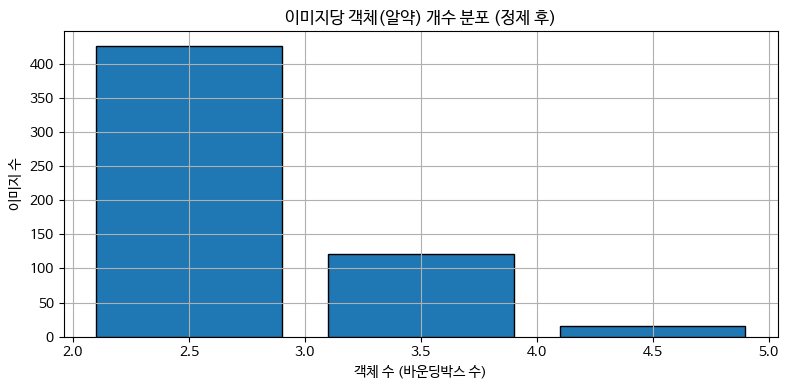

In [ ]:
import matplotlib.pyplot as plt

# ✅ cleaned_df 기준으로 이미지당 객체 수 계산
objects_per_image = cleaned_df['file_name'].value_counts().sort_values()

# 통계 출력
print("✅ 정제된 이미지당 객체 개수 통계:")
print(objects_per_image.describe())

# 히스토그램 시각화
plt.figure(figsize=(8, 4))
objects_per_image.plot(kind='hist', bins=range(2, objects_per_image.max() + 2), edgecolor='black', rwidth=0.8)
plt.title("이미지당 객체(알약) 개수 분포 (정제 후)")
plt.xlabel("객체 수 (바운딩박스 수)")
plt.ylabel("이미지 수")
plt.grid(True)
plt.tight_layout()
plt.show()



## Data imbalance 문제 해결

In [ ]:
print(cleaned_df.columns)


Index(['image_id', 'file_name', 'width', 'height', 'category_id', 'class_name',
       'bbox_x', 'bbox_y', 'bbox_w', 'bbox_h'],
      dtype='object')


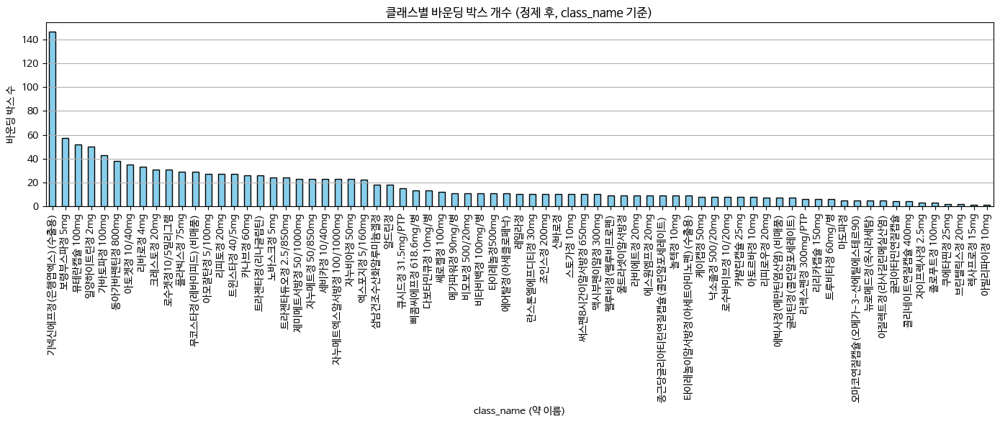

In [ ]:
import matplotlib.pyplot as plt

# ✅ 클래스별 바운딩 박스 수 계산 (약 이름 기준)
class_counts = cleaned_df["class_name"].value_counts()

# ✅ 전체 클래스 시각화
plt.figure(figsize=(14, 6))
class_counts.plot(kind="bar", color="skyblue", edgecolor="black")
plt.title("클래스별 바운딩 박스 개수 (정제 후, class_name 기준)")
plt.xlabel("class_name (약 이름)")
plt.ylabel("바운딩 박스 수")
plt.xticks(rotation=90)
plt.grid(axis="y")
plt.tight_layout()
plt.show()


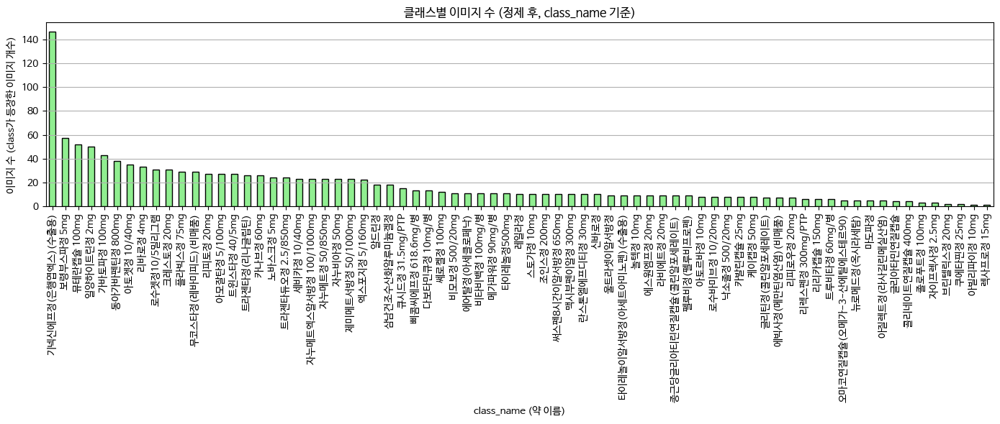

In [ ]:
import matplotlib.pyplot as plt

# ✅ class_name 기준으로 몇 개의 이미지에 등장했는지 세기
class_image_counts = cleaned_df.groupby("class_name")["file_name"].nunique().sort_values(ascending=False)

# ✅ 시각화
plt.figure(figsize=(14, 6))
class_image_counts.plot(kind="bar", color="lightgreen", edgecolor="black")
plt.title("클래스별 이미지 수 (정제 후, class_name 기준)")
plt.xlabel("class_name (약 이름)")
plt.ylabel("이미지 수 (class가 등장한 이미지 개수)")
plt.xticks(rotation=90)
plt.grid(axis="y")
plt.tight_layout()
plt.show()


In [ ]:
cleaned_df["label_idx"].value_counts().plot(kind="bar")

KeyError: 'label_idx'

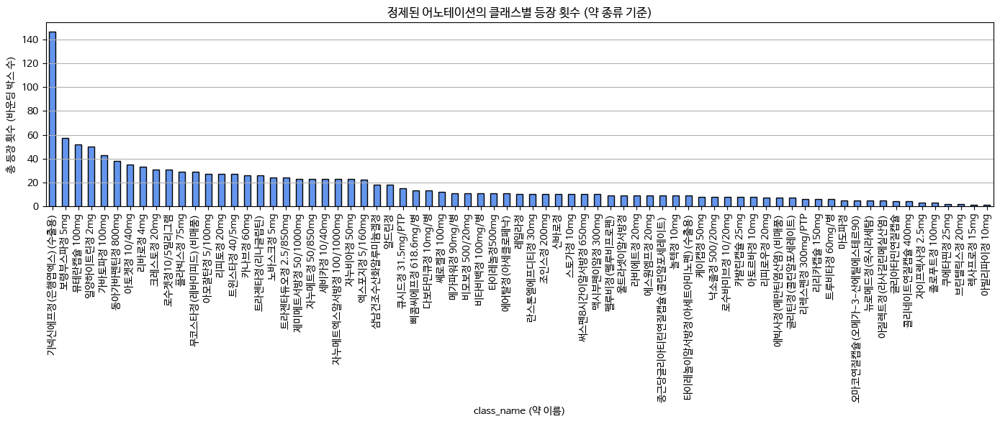

In [ ]:
import matplotlib.pyplot as plt

# 클래스별 count 계산
class_counts = cleaned_df["class_name"].value_counts()

# 시각화
plt.figure(figsize=(14, 6))
class_counts.plot(kind="bar", color="cornflowerblue", edgecolor="black")
plt.title("정제된 어노테이션의 클래스별 등장 횟수 (약 종류 기준)")
plt.xlabel("class_name (약 이름)")
plt.ylabel("총 등장 횟수 (바운딩 박스 수)")
plt.xticks(rotation=90)
plt.grid(axis="y")
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd

# 클래스별 등장 횟수 계산
class_counts = cleaned_df['class_name'].value_counts().reset_index()
class_counts.columns = ['class_name', 'count']

# 행 개수가 너무 많으면 중간 생략
max_rows_to_show = 10

if len(class_counts) > max_rows_to_show:
    head = class_counts.head(max_rows_to_show // 2)
    tail = class_counts.tail(max_rows_to_show // 2)
    skipped_row = pd.DataFrame([['... 생략 ...', '...']], columns=['class_name', 'count'])
    display(pd.concat([head, skipped_row, tail], ignore_index=True))
else:
    display(class_counts)


,class_name,count
0,기넥신에프정(은행엽엑스)(수출용),147
1,보령부스파정 5mg,57
2,뮤테란캡슐 100mg,52
3,일양하이트린정 2mg,50
4,가바토파정 100mg,43
5,... 생략 ...,...
6,졸로푸트정 100mg,3
7,쿠에타핀정 25mg,2
8,브린텔릭스정 20mg,2
9,렉사프로정 15mg,1


<Axes: xlabel='label_idx'>

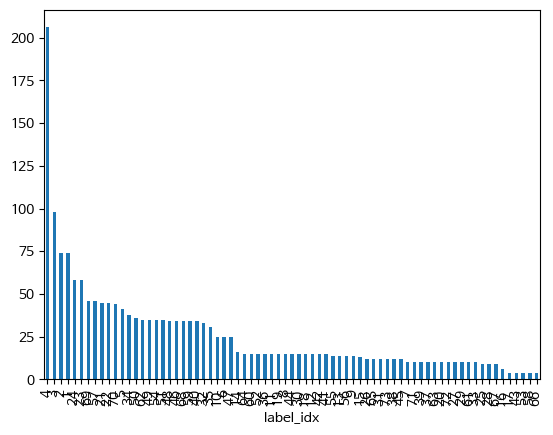

In [ ]:
train_annotations_df["label_idx"].value_counts().plot(kind="bar")

In [ ]:
train_annotations_df["class_name"].value_counts()

,count
class_name,
기넥신에프정(은행엽엑스)(수출용),206
일양하이트린정 2mg,98
뮤테란캡슐 100mg,74
보령부스파정 5mg,74
동아가바펜틴정 800mg,58
...,...
자이프렉사정 2.5mg,4
쿠에타핀정 25mg,4
졸로푸트정 100mg,4


##data imbalance 잡기 (약 개수 차이 보정하기, 클래스 간 차이 너무 심함)

In [ ]:
# 정제된 어노테이션 기준으로 고유 클래스 목록 추출
classes_tmp = cleaned_df["class_name"].unique()
classes_tmp


array(['보령부스파정 5mg', '신바로정', '란스톤엘에프디티정 30mg', '펠루비정(펠루비프로펜)',
       '울트라셋이알서방정', '가바토파정 100mg', '비모보정 500/20mg', '레일라정',
       '낙소졸정 500/20mg', '스토가정 10mg', '라비에트정 20mg', '놀텍정 10mg',
       '케이캡정 50mg', '에스원엠프정 20mg', '동아가바펜틴정 800mg', '뮤테란캡슐 100mg', '알드린정',
       '타이레놀정500mg', '삐콤씨에프정 618.6mg/병', '다보타민큐정 10mg/병', '메가파워정 90mg/병',
       '타이레놀이알서방정(아세트아미노펜)(수출용)', '트루비타정 60mg/병', '비타비백정 100mg/병',
       '리렉스펜정 300mg/PTP', '맥시부펜이알정 300mg', '삼남건조수산화알루미늄겔정',
       '큐시드정 31.5mg/PTP', '써스펜8시간이알서방정 650mg', '일양하이트린정 2mg', '리피토정 20mg',
       '플라빅스정 75mg', '뉴로메드정(옥시라세탐)', '에빅사정(메만틴염산염)(비매품)', '크레스토정 20mg',
       '아토르바정 10mg', '리바로정 4mg', '아토젯정 10/40mg', '로수바미브정 10/20mg',
       '종근당글리아티린연질캡슐(콜린알포세레이트)\xa0', '마도파정', '아질렉트정(라사길린메실산염)',
       '글리아타민연질캡슐', '리리카캡슐 150mg', '글리틴정(콜린알포세레이트)', '카발린캡슐 25mg',
       '오마코연질캡슐(오메가-3-산에틸에스테르90)', '콜리네이트연질캡슐 400mg', '리피로우정 20mg',
       '로수젯정10/5밀리그램', '기넥신에프정(은행엽엑스)(수출용)', '노바스크정 5mg', '자누비아정 50mg',
       '트라젠타정(리나글립틴)', '트라젠타듀오정 2.5/850mg', '자누메트엑스알서

In [ ]:
# 1. 정제된 데이터 기준으로 고유한 category_id와 class_name 쌍 추출 및 정렬
class_mapping_df = (
    cleaned_df[["category_id", "class_name"]]
    .drop_duplicates()
    .sort_values(by="category_id")
)

# 2. class_name 전처리 (괄호 제거, 앞뒤 공백 제거)
sorted_class_names = [
    name.split("(")[0].strip() for name in class_mapping_df["class_name"]
]

# 3. 'background' 클래스 포함
classes = ["background"] + sorted_class_names

# 4. 출력
print(f"총 클래스 개수 (배경 포함): {len(classes)}")
print(f"클래스 리스트: {classes}")


총 클래스 개수 (배경 포함): 74
클래스 리스트: ['background', '보령부스파정 5mg', '뮤테란캡슐 100mg', '일양하이트린정 2mg', '기넥신에프정', '무코스타정', '알드린정', '뉴로메드정', '타이레놀정500mg', '에어탈정', '삼남건조수산화알루미늄겔정', '타이레놀이알서방정', '삐콤씨에프정 618.6mg/병', '조인스정 200mg', '쎄로켈정 100mg', '리렉스펜정 300mg/PTP', '아빌리파이정 10mg', '자이프렉사정 2.5mg', '다보타민큐정 10mg/병', '써스펜8시간이알서방정 650mg', '에빅사정', '리피토정 20mg', '크레스토정 20mg', '가바토파정 100mg', '동아가바펜틴정 800mg', '오마코연질캡슐', '란스톤엘에프디티정 30mg', '리리카캡슐 150mg', '종근당글리아티린연질캡슐', '콜리네이트연질캡슐 400mg', '트루비타정 60mg/병', '스토가정 10mg', '노바스크정 5mg', '마도파정', '플라빅스정 75mg', '엑스포지정 5/160mg', '펠루비정', '아토르바정 10mg', '라비에트정 20mg', '리피로우정 20mg', '자누비아정 50mg', '맥시부펜이알정 300mg', '메가파워정 90mg/병', '쿠에타핀정 25mg', '비타비백정 100mg/병', '놀텍정 10mg', '자누메트정 50/850mg', '큐시드정 31.5mg/PTP', '아모잘탄정 5/100mg', '세비카정 10/40mg', '트윈스타정 40/5mg', '카나브정 60mg', '울트라셋이알서방정', '졸로푸트정 100mg', '트라젠타정', '비모보정 500/20mg', '레일라정', '리바로정 4mg', '렉사프로정 15mg', '트라젠타듀오정 2.5/850mg', '낙소졸정 500/20mg', '아질렉트정', '자누메트엑스알서방정 100/1000mg', '글리아타민연질캡슐', '신바로정', '에스원엠프정 20mg', '브린텔릭스정 20mg', '글리틴정', '제

label_index로 바꾸기 (class name->index변)

In [ ]:
# classes 리스트는 이미 정제된 cleaned_df 기준으로 만들어졌다고 가정
# 예: classes = ["background", "기넥신에프정", "보령부스파정 5mg", ...]

# 클래스 인덱스 → 클래스 이름
class_idx_to_name = {idx: name for idx, name in enumerate(classes)}

# 클래스 이름 → 클래스 인덱스
name_to_class_idx = {name: idx for idx, name in enumerate(classes)}

# 확인용 예시 (존재하는 이름으로 테스트할 것!)
print("예시 class_idx_to_name[1]:", class_idx_to_name[1])
print("예시 name_to_class_idx['플라빅스정 75mg']:", name_to_class_idx.get("플라빅스정 75mg", "❌ 클래스 이름 없음"))



예시 class_idx_to_name[1]: 보령부스파정 5mg
예시 name_to_class_idx['플라빅스정 75mg']: 34


클래스 개수 = 배경 포함 74개

#4. 데이터 증강 및 설계 적용

##Albumentations 기반  transform 정의(수정 가능)

In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

# ✅ Train용 증강 (다양한 일반적인 Object Detection 증강 포함)
train_transforms = A.Compose([
    A.Resize(512, 512),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.3),
    A.RandomRotate90(p=0.3),
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=10, p=0.5),

    A.RandomBrightnessContrast(p=0.3),
    A.HueSaturationValue(p=0.3),
    A.RGBShift(r_shift_limit=10, g_shift_limit=10, b_shift_limit=10, p=0.3),
    A.ChannelShuffle(p=0.1),

    A.MotionBlur(p=0.2),
    A.GaussianBlur(p=0.2),
    A.MedianBlur(blur_limit=3, p=0.1),

    A.CLAHE(p=0.1),
    A.ToGray(p=0.1),

    #A.Cutout(num_holes=4, max_h_size=32, max_w_size=32, fill_value=0, p=0.2),
    #A.CoarseDropout(max_holes=2, max_height=32, max_width=32, p=0.2),

    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2()
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels']))

# ✅ Val / Test 용: 증강 없이 정규화만 수행
val_transforms = A.Compose([
    A.Resize(512, 512),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2()
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels']))

test_transforms = A.Compose([
    A.Resize(512, 512),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])


In [ ]:
# DataLoader에서 이미지와 타겟을 리스트로 묶어주는 함수
def collate_fn(batch):
    return tuple(zip(*batch))

#Augmentation(데이터 증강) 소수 클래스 타겟

In [ ]:
import pandas as pd

# 1. 클래스별 바운딩 박스 수 count
class_counts = cleaned_df["class_name"].value_counts().sort_values(ascending=False)

# 2. 최대 클래스 등장 수를 기준으로 uniform target 설정
target_count = class_counts.max()

# 3. 각 클래스별로 증강이 필요한 수 계산
augmentation_plan = pd.DataFrame({
    "class_name": class_counts.index,
    "current_count": class_counts.values,
})
augmentation_plan["target_count"] = target_count
augmentation_plan["augmentation_needed"] = augmentation_plan["target_count"] - augmentation_plan["current_count"]

# 4. 실제로 증강이 필요한 클래스만 필터링
augmentation_plan = augmentation_plan[augmentation_plan["augmentation_needed"] > 0].reset_index(drop=True)

# 5. 결과 확인
print("✅ 증강이 필요한 클래스 수:", len(augmentation_plan))
display(augmentation_plan.head())


NameError: name 'cleaned_df' is not defined

In [ ]:
import pandas as pd
from sklearn.utils import resample

# 원본 데이터 로드
df = cleaned_df.copy()

# 클래스별로 필요한 수만큼 증강
augmented_list = []
for _, row in augmentation_plan.iterrows():
    class_name = row['class_name']
    n_needed = row['augmentation_needed']

    # 해당 클래스만 추출
    class_subset = df[df['class_name'] == class_name]

    # 중복 허용하여 샘플링 (resample with replacement)
    augmented = resample(class_subset, replace=True, n_samples=n_needed, random_state=42)
    augmented['augmented'] = True  # 증강된 데이터 표시
    augmented_list.append(augmented)

# 증강 데이터 통합
augmented_df = pd.concat(augmented_list, ignore_index=True)

# 원본에도 증강 여부 컬럼 추가
df['augmented'] = False

# 통합 데이터프레임 생성
final_df = pd.concat([df, augmented_df], ignore_index=True)

# 저장
final_df.to_csv("train_aug_uniform.csv", index=False)
print("✅ 증강 완료. 저장 파일: train_aug_uniform.csv")


NameError: name 'augmentation_plan' is not defined

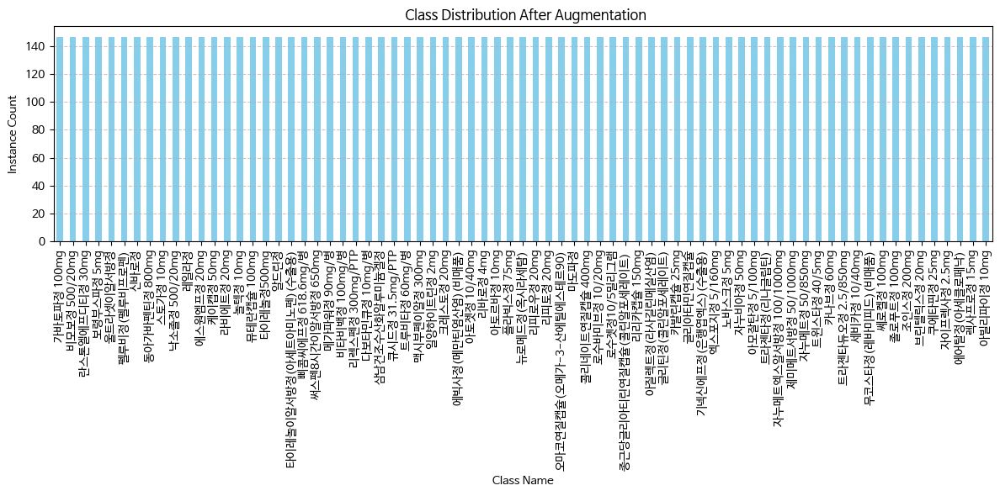

In [ ]:
import matplotlib.pyplot as plt

# 시각화를 위한 클래스 분포 확인
class_counts_after = final_df["class_name"].value_counts().sort_values(ascending=False)

plt.figure(figsize=(12, 6))
class_counts_after.plot(kind='bar', color='skyblue')
plt.title("📊 Class Distribution After Augmentation")
plt.xlabel("Class Name")
plt.ylabel("Instance Count")
plt.xticks(rotation=90)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
from sklearn.utils import resample
import matplotlib.pyplot as plt

# 클래스별 개수
class_counts = cleaned_df["class_name"].value_counts()

# 증강 계획 생성
augmentation_plan = pd.DataFrame({
    "class_name": class_counts.index,
    "current_count": class_counts.values
})

# 조건부 타겟 수 설정
def get_target_count(count):
    if count <= 10:
        return 50
    elif count <= 50:
        return 100
    elif count <= 100:
        return 147
    else:
        return count  # 100개 초과는 증강 안 함

augmentation_plan["target_count"] = augmentation_plan["current_count"].apply(get_target_count)
augmentation_plan["augmentation_needed"] = augmentation_plan["target_count"] - augmentation_plan["current_count"]

# 증강 필요한 클래스만 필터링
augmentation_plan = augmentation_plan[augmentation_plan["augmentation_needed"] > 0].reset_index(drop=True)

print(f"📦 증강 대상 클래스 수: {len(augmentation_plan)}")
display(augmentation_plan.head())


📦 증강 대상 클래스 수: 72


,class_name,current_count,target_count,augmentation_needed
0,보령부스파정 5mg,57,147,90
1,뮤테란캡슐 100mg,52,147,95
2,일양하이트린정 2mg,50,100,50
3,가바토파정 100mg,43,100,57
4,동아가바펜틴정 800mg,38,100,62


In [ ]:
df = cleaned_df.copy()
df["augmented"] = False

augmented_list = []

for _, row in augmentation_plan.iterrows():
    class_name = row["class_name"]
    n_needed = row["augmentation_needed"]

    class_subset = df[df["class_name"] == class_name]
    augmented = resample(class_subset, replace=True, n_samples=n_needed, random_state=42)
    augmented["augmented"] = True
    augmented_list.append(augmented)

# 증강된 데이터 합치기
augmented_df = pd.concat(augmented_list, ignore_index=True)
final_df = pd.concat([df, augmented_df], ignore_index=True)

# 저장
final_df.to_csv("train_aug_rule_based.csv", index=False)
print("✅ 조건부 증강 완료! 저장 파일: train_aug_rule_based.csv")


✅ 조건부 증강 완료! 저장 파일: train_aug_rule_based.csv


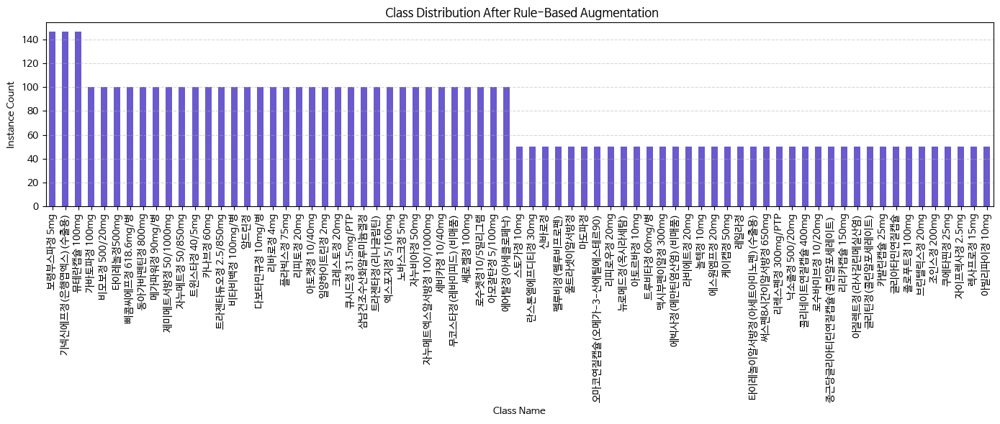

In [ ]:
class_counts_after = final_df["class_name"].value_counts().sort_values(ascending=False)

plt.figure(figsize=(14, 6))
class_counts_after.plot(kind='bar', color='slateblue')
plt.title("📊 Class Distribution After Rule-Based Augmentation")
plt.xlabel("Class Name")
plt.ylabel("Instance Count")
plt.xticks(rotation=90)
plt.grid(axis="y", linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()


#pilldataset 정의

PyTorch용 커스텀 데이터셋 클래스, 객체 탐지 학습 위함

df 기반 바운딩 박스 정보 있는 이미지들 로딩, 이미지 별 바우딩 박스 및 라벨 정보 정제 -> pytorch 학습에 적합한 형태로 반

In [ ]:
from torch.utils.data import Dataset
from pathlib import Path
import cv2
import numpy as np
import torch

class PillDataset(Dataset):
    def __init__(self, df, image_dir, mode="train", transforms=None):
        self.df = df
        self.image_dir = Path(image_dir)
        self.mode = mode
        self.transforms = transforms
        self.image_ids = self.df["file_name"].unique()

    def __len__(self):
        return len(self.image_ids)

    def __getitem__(self, idx):
        image_id = self.image_ids[idx]
        image_path = self.image_dir / image_id

        image = cv2.imread(str(image_path))
        if image is None:
            raise FileNotFoundError(f"Error: Could not load image at path: {image_path}")
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        h, w, _ = image.shape

        if self.mode in ["train", "val"]:
            records = self.df[self.df["file_name"] == image_id]
            boxes = records[["bbox_x", "bbox_y", "bbox_w", "bbox_h"]].values

            # [x_min, y_min, x_max, y_max]로 변환
            boxes[:, 2] = boxes[:, 0] + boxes[:, 2]
            boxes[:, 3] = boxes[:, 1] + boxes[:, 3]

            labels = records["label_idx"].values

            # 정규화 (0~1)
            boxes = boxes.astype(np.float32)
            boxes[:, [0, 2]] /= w
            boxes[:, [1, 3]] /= h

            if self.transforms:
                try:
                    transformed = self.transforms(image=image, bboxes=boxes, labels=labels)
                    image = transformed["image"]
                    boxes = transformed["bboxes"]
                    labels = transformed["labels"]
                except Exception as e:
                    print(f"[ERROR] Albumentations failed on image: {image_id}")
                    print(f"Boxes: {boxes}")
                    raise e

            _, new_h, new_w = image.shape
            boxes = torch.as_tensor(boxes, dtype=torch.float32)
            if len(boxes) > 0:
                boxes[:, [0, 2]] *= new_w
                boxes[:, [1, 3]] *= new_h

            target = {
                "boxes": boxes,
                "labels": torch.as_tensor(labels, dtype=torch.int64),
                "image_id": image_id
            }

            if len(target["boxes"]) == 0:
                target["boxes"] = torch.zeros((0, 4), dtype=torch.float32)
                target["labels"] = torch.zeros((0,), dtype=torch.int64)

            return image, target

        elif self.mode == "test":
            if self.transforms:
                transformed = self.transforms(image=image)
                image = transformed["image"]
            return image, image_id


# dataloader구성은 증강 csv 파일 선택에 따라 수정하기

## Dataloader 구성(train_aug_uniform.csv 기준)

csv별 다르게 수정

train_aug_uniform.csv  데이터 로더

In [ ]:
# 라벨 없는 행 제거
df = df.dropna(subset=["label_idx"]).reset_index(drop=True)


In [ ]:
from torch.utils.data import Dataset, DataLoader
import pandas as pd
import os
from sklearn.model_selection import StratifiedGroupKFold
import albumentations as A
from albumentations.pytorch import ToTensorV2
import torch
import random
import numpy as np
import cv2
from pathlib import Path

# -----------------------------
# 시드 고정 함수
# -----------------------------
def seed_everything(seed):
    random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

# -----------------------------
# 설정
# -----------------------------
SEED = 42
BATCH_SIZE = 4

BASE_DIR = "/content/drive/MyDrive/초급 프로젝트 데이터 모음"
CSV_PATH = f"{BASE_DIR}/train_aug_uniform.csv"
TRAIN_IMAGE_DIR = f"{BASE_DIR}/train_normalized"
TEST_IMAGE_DIR = f"{BASE_DIR}/test_images"

seed_everything(SEED)

# -----------------------------
# Albumentations Transforms
# -----------------------------
train_transforms = A.Compose([
    A.Resize(512, 512),
    A.HorizontalFlip(p=0.5),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2()
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels']))

val_transforms = A.Compose([
    A.Resize(512, 512),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2()
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels']))

test_transforms = A.Compose([
    A.Resize(512, 512),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])

# -----------------------------
# Collate Function
# -----------------------------
def collate_fn(batch):
    return tuple(zip(*batch))

# -----------------------------
# Dataset 정의
# -----------------------------
class PillDataset(Dataset):
    def __init__(self, df, image_dir, mode="train", transforms=None):
        self.df = df
        self.image_dir = Path(image_dir)
        self.mode = mode
        self.transforms = transforms
        self.image_ids = self.df["file_name"].unique()

    def __len__(self):
        return len(self.image_ids)

    def __getitem__(self, idx):
        image_id = self.image_ids[idx]
        image_path = self.image_dir / image_id

        image = cv2.imread(str(image_path))
        if image is None:
            raise FileNotFoundError(f"Could not load image: {image_path}")
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        h, w, _ = image.shape

        if self.mode in ["train", "val"]:
            records = self.df[self.df["file_name"] == image_id]
            boxes = records[["bbox_x", "bbox_y", "bbox_w", "bbox_h"]].values

            # [x_min, y_min, x_max, y_max] 변환
            boxes[:, 2] = boxes[:, 0] + boxes[:, 2]
            boxes[:, 3] = boxes[:, 1] + boxes[:, 3]

            labels = records["label_idx"].values

            boxes = boxes.astype(np.float32)
            boxes[:, [0, 2]] /= w
            boxes[:, [1, 3]] /= h

            if self.transforms:
                transformed = self.transforms(image=image, bboxes=boxes, labels=labels)
                image = transformed["image"]
                boxes = torch.tensor(transformed["bboxes"], dtype=torch.float32)
                labels = torch.tensor(transformed["labels"], dtype=torch.int64)

                _, new_h, new_w = image.shape
                boxes[:, [0, 2]] *= new_w
                boxes[:, [1, 3]] *= new_h

            target = {
                "boxes": boxes,
                "labels": labels,
                "image_id": image_id
            }

            return image, target

        else:  # test
            if self.transforms:
                transformed = self.transforms(image=image)
                image = transformed["image"]
            return image, image_id

# -----------------------------
# CSV 로드 및 Fold Split
# -----------------------------
df = pd.read_csv(CSV_PATH)
df = df.dropna(subset=["label_idx"])  # NaN 제거

labels = df["label_idx"]
groups = df["file_name"]

cv = StratifiedGroupKFold(n_splits=5, shuffle=True, random_state=SEED)
train_idx, val_idx = next(cv.split(df, labels, groups))

train_df_kfold = df.iloc[train_idx].reset_index(drop=True)
val_df_kfold = df.iloc[val_idx].reset_index(drop=True)

# -----------------------------
# Dataset & DataLoader 정의
# -----------------------------
train_dataset = PillDataset(train_df_kfold, TRAIN_IMAGE_DIR, mode="train", transforms=train_transforms)
val_dataset = PillDataset(val_df_kfold, TRAIN_IMAGE_DIR, mode="val", transforms=val_transforms)

test_file_names = sorted(os.listdir(TEST_IMAGE_DIR))
test_df = pd.DataFrame({"file_name": test_file_names})
test_dataset = PillDataset(test_df, TEST_IMAGE_DIR, mode="test", transforms=test_transforms)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, collate_fn=collate_fn)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)


In [ ]:
import random, os, numpy as np, torch
import pandas as pd
from sklearn.model_selection import StratifiedGroupKFold
from torch.utils.data import DataLoader, Dataset
from pathlib import Path
from PIL import Image
import cv2
import albumentations as A
from albumentations.pytorch import ToTensorV2

# -----------------------------
# 1. 시드 고정 함수
# -----------------------------
def seed_everything(seed):
    random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    print(f"Seed set to {seed}")

# -----------------------------
# 2. 설정값
# -----------------------------
SEED = 42
BATCH_SIZE = 4

BASE_DIR = "/content/drive/MyDrive/초급 프로젝트 데이터 모음"
SAVE_PATH = f"{BASE_DIR}/train_aug_uniform.csv"
TRAIN_IMAGE_DIR = f"{BASE_DIR}/train_normalized"
TEST_IMAGE_DIR = f"{BASE_DIR}/test_images"
DUMMY_PATH = f"{BASE_DIR}/train_df_dummy.csv"

# -----------------------------
# 3. seed 고정
# -----------------------------
seed_everything(SEED)

# -----------------------------
# 4. Albumentations Transforms 정의
# -----------------------------
train_transforms = A.Compose([
    A.Resize(512, 512),
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2()
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels']))

val_transforms = A.Compose([
    A.Resize(512, 512),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2()
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels']))

test_transforms = A.Compose([
    A.Resize(512, 512),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225)),
    ToTensorV2()
])

# -----------------------------
# 5. Collate Function
# -----------------------------
def collate_fn(batch):
    return tuple(zip(*batch))

# -----------------------------
# 6. Dataset 클래스 정의
# -----------------------------
class PillDataset(Dataset):
    def __init__(self, df, image_dir, mode="train", transforms=None):
        self.df = df
        self.image_dir = Path(image_dir)
        self.mode = mode
        self.transforms = transforms
        self.image_ids = self.df["file_name"].unique()

    def __len__(self):
        return len(self.image_ids)

    def __getitem__(self, idx):
        image_id = self.image_ids[idx]
        image_path = self.image_dir / image_id
        image = cv2.imread(str(image_path))
        if image is None:
            raise FileNotFoundError(f"Could not read image: {image_path}")
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        h, w, _ = image.shape

        if self.mode in ["train", "val"]:
            records = self.df[self.df["file_name"] == image_id]
            boxes = records[["bbox_x", "bbox_y", "bbox_w", "bbox_h"]].values

            # [x_min, y_min, x_max, y_max]
            boxes[:, 2] = boxes[:, 0] + boxes[:, 2]
            boxes[:, 3] = boxes[:, 1] + boxes[:, 3]

            labels = records["label_idx"].values

            boxes = boxes.astype(np.float32)
            boxes[:, [0, 2]] /= w
            boxes[:, [1, 3]] /= h

            if self.transforms:
                transformed = self.transforms(image=image, bboxes=boxes, labels=labels)
                image = transformed["image"]
                boxes = torch.tensor(transformed["bboxes"], dtype=torch.float32)
                labels = torch.tensor(transformed["labels"], dtype=torch.int64)

                _, new_h, new_w = image.shape
                boxes[:, [0, 2]] *= new_w
                boxes[:, [1, 3]] *= new_h

            target = {
                "boxes": boxes,
                "labels": labels,
                "image_id": image_id
            }
            return image, target

        else:  # test
            if self.transforms:
                transformed = self.transforms(image=image)
                image = transformed["image"]
            return image, image_id

# -----------------------------
# 7. 데이터 로드 및 Split
# -----------------------------
df = pd.read_csv(SAVE_PATH)
df = df.dropna(subset=["label_idx"]).reset_index(drop=True)

groups = df["file_name"]
labels = df["label_idx"]

cv = StratifiedGroupKFold(n_splits=5, shuffle=True, random_state=SEED)
train_idxs, val_idxs = next(cv.split(df, labels, groups))

train_df_kfold = df.iloc[train_idxs].reset_index(drop=True)
val_df_kfold = df.iloc[val_idxs].reset_index(drop=True)

# -----------------------------
# 8. Dataset 및 DataLoader 생성
# -----------------------------
train_dataset = PillDataset(train_df_kfold, TRAIN_IMAGE_DIR, mode="train", transforms=train_transforms)
val_dataset = PillDataset(val_df_kfold, TRAIN_IMAGE_DIR, mode="val", transforms=val_transforms)

test_df = pd.DataFrame({"file_name": sorted(os.listdir(TEST_IMAGE_DIR))})
test_dataset = PillDataset(test_df, TEST_IMAGE_DIR, mode="test", transforms=test_transforms)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, collate_fn=collate_fn)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_fn)

# -----------------------------
# 9. Dummy loader (시각화나 테스트용)
# -----------------------------
# train set에서 이미지 샘플 8장 뽑기 (클래스 다양성 위해 stratify 고려 가능)
dummy_file_names = train_df_kfold["file_name"].unique()[:8]
dummy_df = train_df_kfold[train_df_kfold["file_name"].isin(dummy_file_names)].reset_index(drop=True)

dummy_dataset = PillDataset(dummy_df, TRAIN_IMAGE_DIR, mode="test", transforms=test_transforms)
dummy_loader = DataLoader(dummy_dataset, batch_size=4, shuffle=False, collate_fn=collate_fn)


Seed set to 42


#모델 실험

In [9]:
!git clone https://github.com/soohyun-chris-jeon/AI03-Project-1.git
%cd AI03-Project-1


Cloning into 'AI03-Project-1'...
remote: Enumerating objects: 499, done.
remote: Counting objects: 100% (188/188), done.
remote: Compressing objects: 100% (108/108), done.
remote: Total 499 (delta 99), reused 145 (delta 79), pack-reused 311 (from 2)
Receiving objects: 100% (499/499), 90.12 MiB | 13.63 MiB/s, done.
Resolving deltas: 100% (258/258), done.

/content/drive/MyDrive/초급 프로젝트 데이터 모음/AI03-Project-1


In [11]:
!git checkout -b feature/eunyoung

fatal: You are on a branch yet to be born


In [14]:
!mv /content/경구 약제 이미지 객체 검출 프로젝트 (dataset).ipynb notebooks/final_dataset.ipynb


/bin/bash: -c: line 1: syntax error near unexpected token `('
/bin/bash: -c: line 1: `mv /content/경구 약제 이미지 객체 검출 프로젝트 (dataset).ipynb notebooks/final_dataset.ipynb'
